In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/numerical-one-hand-sign/Data Sign lanuage/valid/labels/Sign-7-Sample-382-_jpg.rf.5365c8009eb8b576c0f2f6a6b93f8a62.txt
/kaggle/input/numerical-one-hand-sign/Data Sign lanuage/valid/labels/Sign-9-Sample-476-_jpg.rf.f1353463cc0100d644a7fe6fcd0a4267.txt
/kaggle/input/numerical-one-hand-sign/Data Sign lanuage/valid/labels/Sign-8-Sample-409-_jpg.rf.c75bb8ab6b50cfe955ff6ac58b27e62c.txt
/kaggle/input/numerical-one-hand-sign/Data Sign lanuage/valid/labels/Sign-6-Sample-335-_jpg.rf.27e9acc1828243a7c51a5e4edec5d3ad.txt
/kaggle/input/numerical-one-hand-sign/Data Sign lanuage/valid/labels/Sign-1-Sample-76-_jpg.rf.9a3799ef770a5fa296cf167d6553209a.txt
/kaggle/input/numerical-one-hand-sign/Data Sign lanuage/valid/labels/Sign-1-Sample-90-_jpg.rf.f86dea2c1f2dea6f16d16e283216e613.txt
/kaggle/input/numerical-one-hand-sign/Data Sign lanuage/valid/labels/Sign-1-Sample-52-_jpg.rf.93747fc724a55de4f1f16ce17818064d.txt
/kaggle/input/numerical-one-hand-sign/Data Sign lanuage/valid/labels/Sign-5-Sam

# **Improting The Libary of Yolo**

In [2]:
# !pip install ultralytics 
# !pip install -U albumentations
!pip install -U ultralytics
!apt-get update && apt-get install -y fonts-noto

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 922.2/922.2 kB 15.8 MB/s eta 0:00:00a 0:00:01
Get:1 https://cloud.r-project.org/bin/linux/ubuntu jammy-cran40/ InRelease [3,632 B]
Hit:2 http://archive.ubuntu.com/ubuntu jammy InRelease                                              
Get:3 http://security.ubuntu.com/ubuntu jammy-security InRelease [129 kB]                           
Get:4 https://r2u.stat.illinois.edu/ubuntu jammy InRelease [6,555 B]                                
Get:5 http://archive.ubuntu.com/ubuntu jammy-updates InRelease [128 kB]                             
Get:6 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  InRelease [1,581 B]
Get:7 https://cloud.r-project.org/bin/linux/ubuntu jammy-cran40/ Packages [68.9 kB]                 
Get:8 https://ppa.launchpadcontent.net/deadsnakes/ppa/ubuntu jammy InRelease [18.1 kB]              
Get:9 http://archive.ubuntu.com/ubuntu jammy-backports InRelease [127 kB]       
Get:10 https://r2u.stat.illinois.edu

In [3]:
# Import libraries
import yaml
import matplotlib.pyplot as plt
import matplotlib.font_manager as fm
from ultralytics import YOLO

# Configure Matplotlib to use Noto Sans Bengali
font_path = "/usr/share/fonts/truetype/noto/NotoSansBengali-Regular.ttf"  # Path after installing fonts-noto
if os.path.exists(font_path):
    font_prop = fm.FontProperties(fname=font_path)
    plt.rcParams['font.family'] = font_prop.get_name()
    print("✅ Bangla font 'Noto Sans Bengali' configured for Matplotlib!")
else:
    print("⚠️ Noto Sans Bengali font not found. Plots may not render Bangla correctly.")

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.
✅ Bangla font 'Noto Sans Bengali' configured for Matplotlib!


In [ ]:
# dataset_yaml = {
#     "train": "/kaggle/input/numerical-one-hand-sign/Data Sign Language/train/images",
#     "val": "/kaggle/input/numerical-one-hand-sign/Data Sign Language/valid/images",
#     "nc": 10,
#     "names": {0: "০", 1: "১", 2: "২", 3: "৩", 4: "৪", 5: "৫", 6: "৬", 7: "৭", 8: "৮", 9: "৯"}
# }

# # Save dataset.yaml with UTF-8 encoding
# with open('/kaggle/working/dataset.yaml', 'w', encoding='utf-8') as file:
#     yaml.dump(dataset_yaml, file, allow_unicode=True)

# print("✅ dataset.yaml with Bangla labels created successfully!")

In [ ]:
# dataset_yaml = """
# train: /kaggle/input/sign-numerical/bangla sing numeric data/train/images
# val: /kaggle/input/sign-numerical/bangla sing numeric data/val/images

# nc: 10  

# names:
#   - sign_0
#   - sign_1
#   - sign_2
#   - sign_3
#   - sign_4
#   - sign_5
#   - sign_6
#   - sign_7
#   - sign_8
#   - sign_9
# """

# with open('/kaggle/working/dataset.yaml', 'w') as file:
#     file.write(dataset_yaml)

# print("dataset.yaml created successfully!")

In [4]:
import yaml
from ultralytics import YOLO

# ============================
# 1. Dataset Configuration
# ============================
dataset_yaml = {
    "train": "/kaggle/input/numerical-one-hand-sign/Data Sign lanuage/train/images",
    "val": "/kaggle/input/numerical-one-hand-sign/Data Sign lanuage/valid/images",
    "nc": 10,
    "names": {
        0: "০",
        1: "১",
        2: "২",
        3: "৩",
        4: "৪",
        5: "৫",
        6: "৬",
        7: "৭",
        8: "৮",
        9: "৯",
    }
}

# Save dataset.yaml with UTF-8 encoding
with open('/kaggle/working/dataset.yaml', 'w', encoding='utf-8') as file:
    yaml.dump(dataset_yaml, file, allow_unicode=True)

print("✅ dataset.yaml created successfully!")
print("Train images:", len(os.listdir(dataset_yaml["train"])))
print("Val images:", len(os.listdir(dataset_yaml["val"])))

✅ dataset.yaml created successfully!
Train images: 1500
Val images: 468


In [5]:
!pip install -U ultralytics

In [6]:
from ultralytics import YOLO

# Initialize YOLOv11m model (downloads automatically)
model = YOLO("yolov8m.pt")  # Medium model for balance

# Train the model
results = model.train(
    data="/kaggle/working/dataset.yaml",
    epochs=100,  # Increased to allow better convergence
    patience=80,  # Increased patience (comment says 200, set to 80)
    imgsz=640,
    batch=8,  # Safe for Kaggle P100 GPU
    optimizer='AdamW',
    lr0=0.001,  # Balanced learning rate
    lrf=0.01,  # Default final learning rate
    weight_decay=0.00025,
    hsv_h=0.01,
    hsv_s=0.5,
    hsv_v=0.3,
    mosaic=0.8,  # Increased for generalization
    mixup=0.1,
    copy_paste=0.1,
    auto_augment='randaugment',
    erasing=0.3,
    label_smoothing=0.05,
    warmup_epochs=5,
    device='cuda',  # Explicitly use Kaggle GPU
    workers=4,
    amp=True,  # Mixed precision for speed/memory
    close_mosaic=10,
    dropout=0.1
)

print("✅ Training completed! Download 'best.pt' from /kaggle/working/runs/detect/train/weights/")

100%|██████████| 49.7M/49.7M [00:00<00:00, 271MB/s]


WARNING ⚠️ 'label_smoothing' is deprecated and will be removed in in the future.
Ultralytics 8.3.85 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
engine/trainer: task=detect, mode=train, model=yolov8m.pt, data=/kaggle/working/dataset.yaml, epochs=100, time=None, patience=80, batch=8, imgsz=640, save=True, save_period=-1, cache=False, device=cuda, workers=4, project=None, name=train, exist_ok=False, pretrained=True, optimizer=AdamW, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.1, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False,

100%|██████████| 22.2M/22.2M [00:00<00:00, 167MB/s]


Overriding model.yaml nc=80 with nc=10

                   from  n    params  module                                       arguments                     
  0                  -1  1      1392  ultralytics.nn.modules.conv.Conv             [3, 48, 3, 2]                 
  1                  -1  1     41664  ultralytics.nn.modules.conv.Conv             [48, 96, 3, 2]                
  2                  -1  2    111360  ultralytics.nn.modules.block.C2f             [96, 96, 2, True]             
  3                  -1  1    166272  ultralytics.nn.modules.conv.Conv             [96, 192, 3, 2]               
  4                  -1  4    813312  ultralytics.nn.modules.block.C2f             [192, 192, 4, True]           
  5                  -1  1    664320  ultralytics.nn.modules.conv.Conv             [192, 384, 3, 2]              
  6                  -1  4   3248640  ultralytics.nn.modules.block.C2f             [384, 384, 4, True]           
  7                  -1  1   1991808  ultralytic

100%|██████████| 5.35M/5.35M [00:00<00:00, 76.8MB/s]


AMP: checks passed ✅


train: Scanning /kaggle/input/numerical-one-hand-sign/Data Sign lanuage/train/labels... 1500 images, 0 backgrounds, 0 corrupt: 100%|██████████| 1500/1500 [00:05<00:00, 271.23it/s]

train: WARNING ⚠️ Cache directory /kaggle/input/numerical-one-hand-sign/Data Sign lanuage/train is not writeable, cache not saved.


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


/usr/local/lib/python3.10/dist-packages/albumentations/__init__.py:24: UserWarning: A new version of Albumentations is available: 2.0.5 (you have 1.4.20). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()
val: Scanning /kaggle/input/numerical-one-hand-sign/Data Sign lanuage/valid/labels... 468 images, 0 backgrounds, 0 corrupt: 100%|██████████| 468/468 [00:01<00:00, 243.66it/s]

val: WARNING ⚠️ Cache directory /kaggle/input/numerical-one-hand-sign/Data Sign lanuage/valid is not writeable, cache not saved.


Plotting labels to runs/detect/train/labels.jpg... 


/usr/local/lib/python3.10/dist-packages/ultralytics/utils/plotting.py:981: UserWarning: Glyph 2534 (\N{BENGALI DIGIT ZERO}) missing from current font.
  plt.savefig(fname, dpi=200)
/usr/local/lib/python3.10/dist-packages/ultralytics/utils/plotting.py:981: UserWarning: Matplotlib currently does not support Bengali natively.
  plt.savefig(fname, dpi=200)
/usr/local/lib/python3.10/dist-packages/ultralytics/utils/plotting.py:981: UserWarning: Glyph 2535 (\N{BENGALI DIGIT ONE}) missing from current font.
  plt.savefig(fname, dpi=200)
/usr/local/lib/python3.10/dist-packages/ultralytics/utils/plotting.py:981: UserWarning: Glyph 2536 (\N{BENGALI DIGIT TWO}) missing from current font.
  plt.savefig(fname, dpi=200)
/usr/local/lib/python3.10/dist-packages/ultralytics/utils/plotting.py:981: UserWarning: Glyph 2537 (\N{BENGALI DIGIT THREE}) missing from current font.
  plt.savefig(fname, dpi=200)
/usr/local/lib/python3.10/dist-packages/ultralytics/utils/plotting.py:981: UserWarning: Glyph 2538 (\N{

optimizer: AdamW(lr=0.001, momentum=0.937) with parameter groups 77 weight(decay=0.0), 84 weight(decay=0.00025), 83 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 4 dataloader workers
Logging results to runs/detect/train
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100       4.1G      2.284        5.7      2.602         13        640:   1%|          | 2/188 [00:01<01:57,  1.58it/s]


100%|██████████| 755k/755k [00:00<00:00, 18.2MB/s]
      1/100      4.16G      1.255      2.075      1.539         12        640: 100%|██████████| 188/188 [01:08<00:00,  2.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:07<00:00,  3.92it/s]

                   all        468        469      0.473       0.63      0.575      0.372



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/100      4.08G      1.189      1.458      1.439         11        640: 100%|██████████| 188/188 [01:06<00:00,  2.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.62it/s]

                   all        468        469       0.58      0.798      0.768      0.491



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/100      4.14G      1.169      1.338      1.414          9        640: 100%|██████████| 188/188 [01:05<00:00,  2.86it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.61it/s]

                   all        468        469      0.699      0.539      0.679      0.403



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/100      4.23G      1.136      1.292       1.38         13        640: 100%|██████████| 188/188 [01:05<00:00,  2.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.62it/s]

                   all        468        469      0.736      0.748      0.798      0.535



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/100      4.23G      1.131      1.181      1.358          7        640: 100%|██████████| 188/188 [01:05<00:00,  2.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.62it/s]

                   all        468        469      0.606      0.785      0.807      0.535



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/100      4.24G       1.09      1.134      1.341         11        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.65it/s]

                   all        468        469      0.767      0.834      0.843      0.581



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/100      4.23G      1.086      1.091       1.32          6        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.64it/s]

                   all        468        469      0.781       0.74      0.853      0.562



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100      4.14G      1.009     0.9714       1.28          7        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.63it/s]

                   all        468        469      0.854      0.885      0.933       0.66



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/100      4.17G      1.017     0.9181      1.275          8        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.63it/s]

                   all        468        469      0.914      0.866      0.939      0.612



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/100      4.14G     0.9855     0.8999      1.243          7        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.66it/s]

                   all        468        469      0.904      0.911      0.949      0.644



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/100      4.23G     0.9533     0.8763      1.234          8        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.65it/s]

                   all        468        469       0.94      0.823      0.966      0.661



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/100      4.15G     0.9299     0.8358      1.217         12        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.65it/s]

                   all        468        469       0.82      0.826      0.903      0.565



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/100      4.17G     0.9535     0.8395      1.227          7        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.65it/s]

                   all        468        469      0.928      0.965      0.976       0.68



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/100      4.23G     0.9088     0.8147       1.21          8        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.63it/s]

                   all        468        469      0.947       0.91      0.962      0.577



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/100      4.22G     0.9215      0.805      1.201          8        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.66it/s]

                   all        468        469      0.949      0.938      0.975      0.646



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/100      4.19G     0.9066     0.7911      1.204          7        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.64it/s]

                   all        468        469      0.875      0.859       0.92      0.569



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/100      4.16G     0.9081     0.7775      1.199          6        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.66it/s]

                   all        468        469      0.915      0.837      0.934      0.606



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/100      4.16G     0.8975     0.7143      1.182          9        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.67it/s]

                   all        468        469      0.942      0.915      0.941      0.592



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/100      4.13G      0.887     0.7202      1.171         10        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.66it/s]

                   all        468        469       0.91      0.935      0.954       0.63



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/100      4.16G     0.8817     0.7332      1.181         10        640: 100%|██████████| 188/188 [01:05<00:00,  2.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.68it/s]

                   all        468        469      0.975      0.903      0.976      0.695



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/100      4.22G     0.8648     0.6985      1.161         10        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.66it/s]

                   all        468        469      0.936      0.911      0.973      0.619



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/100      4.22G      0.851     0.6892      1.162          9        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.68it/s]

                   all        468        469      0.973      0.917      0.971      0.605



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/100      4.18G      0.848     0.6983      1.169          6        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.67it/s]

                   all        468        469      0.942      0.953      0.959      0.644



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/100      4.22G     0.8564     0.6705      1.164         10        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.69it/s]

                   all        468        469      0.898      0.865      0.955      0.645



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/100      4.22G     0.8499     0.6857      1.171          9        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.66it/s]

                   all        468        469      0.968      0.861      0.928      0.603



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/100      4.13G     0.8276     0.6453      1.142          8        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.65it/s]

                   all        468        469      0.953      0.868      0.955      0.593



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/100      4.22G     0.8364     0.6325      1.154          5        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.66it/s]

                   all        468        469      0.978      0.936      0.969       0.61



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/100      4.18G     0.8413      0.622      1.143          7        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.66it/s]

                   all        468        469      0.949      0.879      0.952       0.58



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/100      4.17G     0.8405     0.6372      1.144         10        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.64it/s]

                   all        468        469      0.966       0.86      0.919       0.58



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/100      4.19G     0.8118     0.5895      1.137          8        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.67it/s]

                   all        468        469      0.909       0.86      0.927      0.587



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/100      4.19G     0.8298      0.605      1.143          8        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.66it/s]

                   all        468        469       0.95      0.942      0.963      0.599



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/100      4.22G     0.8266     0.5955      1.142          7        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.67it/s]

                   all        468        469      0.955      0.902      0.965      0.618



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/100      4.15G     0.8065     0.5763      1.132         17        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.68it/s]

                   all        468        469      0.962       0.93      0.976      0.634



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/100      4.22G      0.808     0.5958      1.136          9        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.67it/s]

                   all        468        469      0.908      0.951      0.973       0.62



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/100      4.12G     0.8065     0.5687      1.129          6        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.67it/s]

                   all        468        469      0.948      0.827      0.938      0.586



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/100      4.22G     0.8038     0.5915       1.13          8        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.66it/s]

                   all        468        469      0.968       0.95      0.977      0.647



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/100      4.18G     0.7941     0.5602      1.119          9        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.68it/s]

                   all        468        469      0.945      0.885      0.945      0.591



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/100      4.16G     0.7886     0.5503      1.119          7        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.68it/s]

                   all        468        469      0.909      0.874      0.939        0.6



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/100      4.22G     0.7982     0.5766      1.124          7        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.66it/s]

                   all        468        469      0.984      0.884      0.947      0.593



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/100      4.13G     0.7947     0.5596      1.116          8        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.67it/s]

                   all        468        469      0.867      0.889       0.94      0.575



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/100      4.17G     0.7783     0.5376      1.105          8        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.67it/s]

                   all        468        469      0.986      0.882      0.941      0.574



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/100      4.13G     0.7768     0.5436      1.112          7        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.65it/s]

                   all        468        469      0.953      0.916      0.937      0.587



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/100      4.16G     0.7769     0.5179      1.113         11        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.66it/s]

                   all        468        469      0.966       0.96       0.97      0.613



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/100      4.22G     0.7671     0.5354       1.11          9        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.68it/s]

                   all        468        469      0.923      0.894      0.936      0.568



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/100      4.16G      0.774     0.5229      1.108         13        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.63it/s]

                   all        468        469      0.913      0.902      0.949      0.593



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/100      4.13G     0.7496     0.5143      1.101         12        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.68it/s]

                   all        468        469      0.913        0.9      0.933      0.591



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/100      4.12G     0.7829     0.5297      1.115          8        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.69it/s]

                   all        468        469      0.938      0.907      0.951      0.596



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/100      4.21G     0.7565     0.5041      1.097          6        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.68it/s]

                   all        468        469      0.888      0.914      0.956        0.6



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/100      4.23G     0.7508     0.5102      1.098          7        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.68it/s]

                   all        468        469      0.921      0.837      0.908      0.554



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/100      4.14G     0.7611     0.5062      1.108          8        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.68it/s]

                   all        468        469      0.866      0.886      0.951      0.602



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/100      4.13G     0.7442     0.4912      1.097          9        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.69it/s]

                   all        468        469      0.941      0.934      0.955      0.575



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/100      4.12G      0.753     0.5034      1.104          8        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.67it/s]

                   all        468        469      0.913      0.867      0.911       0.57



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/100      4.17G     0.7404     0.4827      1.081          7        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.67it/s]

                   all        468        469      0.893      0.869      0.911      0.553



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/100      4.17G      0.734     0.4855      1.095         12        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.68it/s]

                   all        468        469      0.909      0.851      0.917      0.584



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/100      4.18G     0.7514     0.4893      1.099          7        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.66it/s]

                   all        468        469      0.928      0.916      0.962      0.599



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/100      4.22G     0.7351     0.4787      1.083          6        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.68it/s]

                   all        468        469      0.937      0.901      0.936      0.587



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/100      4.18G      0.739     0.4795      1.095          8        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.68it/s]

                   all        468        469      0.928      0.932      0.958      0.603



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/100      4.18G     0.7201     0.4748      1.079         10        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.65it/s]

                   all        468        469      0.947      0.934      0.965      0.605



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/100      4.13G     0.7327     0.4641      1.085          9        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.69it/s]

                   all        468        469      0.914      0.918      0.945      0.594



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/100      4.13G     0.7295     0.4782      1.084         12        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.68it/s]

                   all        468        469      0.866      0.927      0.949      0.607



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/100      4.17G     0.7413     0.4915      1.089          8        640: 100%|██████████| 188/188 [01:05<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.68it/s]

                   all        468        469      0.935       0.91      0.944      0.616



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/100      4.17G     0.7352     0.4708      1.083          9        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.69it/s]

                   all        468        469      0.948       0.92      0.956      0.642



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/100      4.13G     0.7163     0.4422      1.066         13        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.68it/s]

                   all        468        469      0.926      0.938      0.962      0.603



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/100      4.23G     0.7053     0.4357      1.067         12        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.67it/s]

                   all        468        469      0.922      0.931      0.953        0.6



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/100      4.22G     0.7351     0.4608      1.093          7        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.68it/s]

                   all        468        469      0.916      0.943      0.959      0.593



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/100      4.13G     0.7105     0.4559       1.08         11        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.68it/s]

                   all        468        469      0.929      0.946      0.973      0.629



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/100      4.12G      0.707     0.4478       1.07          5        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.68it/s]

                   all        468        469       0.95      0.937      0.973      0.608



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/100      4.17G     0.7102      0.431      1.066         10        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.66it/s]

                   all        468        469      0.896      0.896      0.941      0.577



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/100      4.22G     0.7084     0.4453       1.07          8        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.68it/s]

                   all        468        469      0.951      0.931      0.967      0.593



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/100      4.22G     0.6941     0.4327      1.063         11        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.67it/s]

                   all        468        469      0.933      0.921      0.955      0.599



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/100      4.19G     0.7009     0.4193      1.066         14        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.67it/s]

                   all        468        469      0.931      0.945      0.964      0.623



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/100      4.16G     0.7045     0.4367      1.062          8        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.69it/s]

                   all        468        469      0.912      0.911      0.962      0.621



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/100      4.16G     0.6904      0.423      1.061         12        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.67it/s]

                   all        468        469      0.937      0.897       0.96      0.594



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/100      4.13G     0.7008     0.4112       1.07          9        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.65it/s]

                   all        468        469      0.872      0.898      0.948      0.571



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/100      4.13G     0.6903     0.4194      1.055          8        640: 100%|██████████| 188/188 [01:05<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.68it/s]

                   all        468        469      0.936      0.953      0.977      0.613



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/100      4.22G     0.6843     0.4159      1.054          4        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.69it/s]

                   all        468        469       0.94      0.941      0.974      0.615



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/100      4.22G     0.6834     0.4041      1.056         13        640: 100%|██████████| 188/188 [01:05<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.70it/s]

                   all        468        469      0.912      0.921      0.961       0.59



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/100      4.18G     0.6858     0.4181       1.06         10        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.68it/s]

                   all        468        469      0.867      0.914      0.943      0.568



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/100      4.17G     0.6782     0.3999      1.065         10        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.70it/s]

                   all        468        469      0.933      0.952      0.963      0.593



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/100      4.18G     0.6808      0.413      1.065         11        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.68it/s]

                   all        468        469      0.926      0.933      0.957      0.596



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/100      4.16G      0.672     0.4056      1.047          6        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.67it/s]

                   all        468        469      0.933      0.943      0.958      0.613



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/100      4.21G     0.6906     0.4063       1.06          8        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.69it/s]

                   all        468        469      0.868      0.937      0.944      0.593



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/100      4.13G      0.664     0.3944      1.041          9        640: 100%|██████████| 188/188 [01:05<00:00,  2.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.70it/s]

                   all        468        469      0.892      0.926      0.955      0.568



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/100      4.18G     0.6601     0.3871      1.042          7        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.68it/s]

                   all        468        469      0.845      0.887       0.93      0.565



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/100      4.22G     0.6777     0.4077      1.053          4        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.68it/s]

                   all        468        469      0.885      0.903       0.94      0.555



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/100      4.22G     0.6532     0.3838      1.041          6        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.70it/s]

                   all        468        469      0.911      0.917      0.952      0.589



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/100      4.22G     0.6595     0.3803      1.042         11        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.68it/s]

                   all        468        469      0.925      0.922      0.952      0.575



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/100      4.22G      0.671     0.3839      1.048         13        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.69it/s]

                   all        468        469       0.92      0.921      0.961      0.581



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/100      4.14G     0.6457     0.3705       1.04         14        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.68it/s]

                   all        468        469      0.912      0.927      0.957      0.574



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/100      4.23G      0.647     0.3711      1.038          7        640: 100%|██████████| 188/188 [01:05<00:00,  2.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.68it/s]

                   all        468        469      0.868      0.872      0.939      0.574


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/100      4.22G     0.5737     0.2365      1.007          4        640: 100%|██████████| 188/188 [01:05<00:00,  2.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.67it/s]

                   all        468        469      0.914      0.851      0.942      0.577



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/100      4.13G     0.5722     0.2318      1.007          4        640: 100%|██████████| 188/188 [01:05<00:00,  2.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.69it/s]

                   all        468        469      0.925      0.897      0.959      0.585



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/100      4.22G     0.5724     0.2312      1.001          4        640: 100%|██████████| 188/188 [01:05<00:00,  2.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.70it/s]

                   all        468        469      0.937      0.908      0.947      0.578



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/100      4.12G     0.5677     0.2323      1.012          4        640: 100%|██████████| 188/188 [01:05<00:00,  2.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.70it/s]

                   all        468        469      0.952      0.914      0.956        0.6



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/100      4.22G     0.5622     0.2265      1.003          4        640: 100%|██████████| 188/188 [01:05<00:00,  2.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.69it/s]

                   all        468        469      0.933      0.918      0.959      0.594



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/100      4.16G     0.5605     0.2264      1.002          4        640: 100%|██████████| 188/188 [01:05<00:00,  2.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.69it/s]

                   all        468        469      0.919      0.893      0.941      0.577



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/100      4.22G     0.5539     0.2246     0.9993          4        640: 100%|██████████| 188/188 [01:05<00:00,  2.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.70it/s]

                   all        468        469      0.916      0.904      0.948      0.599



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/100      4.12G     0.5547     0.2214     0.9837          4        640: 100%|██████████| 188/188 [01:05<00:00,  2.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.70it/s]

                   all        468        469      0.912      0.913      0.949      0.597



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/100      4.13G     0.5462     0.2201     0.9919          4        640: 100%|██████████| 188/188 [01:05<00:00,  2.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.70it/s]

                   all        468        469      0.925      0.875      0.937      0.593



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/100      4.18G     0.5457     0.2178     0.9837          4        640: 100%|██████████| 188/188 [01:05<00:00,  2.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.67it/s]

                   all        468        469      0.928       0.88      0.941      0.591
EarlyStopping: Training stopped early as no improvement observed in last 80 epochs. Best results observed at epoch 20, best model saved as best.pt.
To update EarlyStopping(patience=80) pass a new patience value, i.e. `patience=300` or use `patience=0` to disable EarlyStopping.



100 epochs completed in 2.028 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 52.0MB
Optimizer stripped from runs/detect/train/weights/best.pt, 52.0MB

Validating runs/detect/train/weights/best.pt...
Ultralytics 8.3.85 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
Model summary (fused): 92 layers, 25,845,550 parameters, 0 gradients, 78.7 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:06<00:00,  4.39it/s]
/usr/local/lib/python3.10/dist-packages/ultralytics/utils/metrics.py:474: UserWarning: Glyph 2534 (\N{BENGALI DIGIT ZERO}) missing from current font.
  fig.savefig(save_dir, dpi=250)
/usr/local/lib/python3.10/dist-packages/ultralytics/utils/metrics.py:474: UserWarning: Matplotlib currently does not support Bengali natively.
  fig.savefig(save_dir, dpi=250)
/usr/local/lib/python3.10/dist-packages/ultralytics/utils/metrics.py:474: UserWarning: Glyph 2535 (\N{BENGALI DIGIT ONE}) missing from current font.
  fig.savefig(save_dir, dpi=250)
/usr/local/lib/python3.10/dist-packages/ultralytics/utils/metrics.py:474: UserWarning: Glyph 2536 (\N{BENGALI DIGIT TWO}) missing from current font.
  fig.savefig(save_dir, dpi=250)
/usr/local/lib/python3.10/dist-packages/ultralytics/utils/metrics.py:474: UserWarning: Glyph 2537 (\N{BENGALI DIGIT THREE}) missing from cu

                   all        468        469      0.975      0.903      0.977      0.697
                     ০         50         50          1      0.749      0.995      0.721
                     ১         50         50      0.948          1      0.995       0.71
                     ২         50         50      0.987          1      0.995      0.739
                     ৩         43         43          1      0.882      0.972       0.72
                     ৪         37         37      0.865          1      0.979      0.611
                     ৫         50         50          1      0.867      0.995      0.553
                     ৬         40         41          1      0.846      0.902      0.628
                     ৭         49         49          1       0.95      0.989      0.806
                     ৮         49         49      0.949          1      0.995      0.845
                     ৯         50         50          1      0.735      0.948      0.637


/usr/local/lib/python3.10/dist-packages/ultralytics/utils/metrics.py:436: UserWarning: Glyph 2534 (\N{BENGALI DIGIT ZERO}) missing from current font.
  fig.savefig(plot_fname, dpi=250)
/usr/local/lib/python3.10/dist-packages/ultralytics/utils/metrics.py:436: UserWarning: Matplotlib currently does not support Bengali natively.
  fig.savefig(plot_fname, dpi=250)
/usr/local/lib/python3.10/dist-packages/ultralytics/utils/metrics.py:436: UserWarning: Glyph 2535 (\N{BENGALI DIGIT ONE}) missing from current font.
  fig.savefig(plot_fname, dpi=250)
/usr/local/lib/python3.10/dist-packages/ultralytics/utils/metrics.py:436: UserWarning: Glyph 2536 (\N{BENGALI DIGIT TWO}) missing from current font.
  fig.savefig(plot_fname, dpi=250)
/usr/local/lib/python3.10/dist-packages/ultralytics/utils/metrics.py:436: UserWarning: Glyph 2537 (\N{BENGALI DIGIT THREE}) missing from current font.
  fig.savefig(plot_fname, dpi=250)
/usr/local/lib/python3.10/dist-packages/ultralytics/utils/metrics.py:436: UserWarni

Speed: 0.2ms preprocess, 10.8ms inference, 0.0ms loss, 1.2ms postprocess per image
Results saved to runs/detect/train
✅ Training completed! Download 'best.pt' from /kaggle/working/runs/detect/train/weights/


In [ ]:
# import yaml
# from ultralytics import YOLO

# # Dataset with Bangla labels
# dataset_yaml = {
#     "train": "/kaggle/input/numerical-one-hand-sign/Data Sign Language/train/images",
#     "val": "/kaggle/input/numerical-one-hand-sign/Data Sign Language/valid/images",
#     "nc": 10,
#     "names": {0: "০", 1: "১", 2: "২", 3: "৩", 4: "৪", 5: "৫", 6: "৬", 7: "৭", 8: "৮", 9: "৯"}
# }
# with open('/kaggle/working/dataset.yaml', 'w', encoding='utf-8') as file:
#     yaml.dump(dataset_yaml, file, allow_unicode=True)
    
# print("✅ dataset.yaml created successfully!")
    

In [ ]:

# model = YOLO("yolov11m.pt")  # Medium variant
# results = model.train(
#     data="/kaggle/working/dataset.yaml",
#     epochs=50,
#     patience=20,
#     imgsz=640,
#     batch=8,
#     optimizer='AdamW',
#     lr0=0.001,
#     lrf=0.01,
#     weight_decay=0.00025,
#     hsv_h=0.01,
#     hsv_s=0.5,
#     hsv_v=0.3,
#     mosaic=0.8,
#     mixup=0.1,
#     copy_paste=0.1,
#     auto_augment='randaugment',
#     erasing=0.3,
#     label_smoothing=0.05,
#     warmup_epochs=5,
#     device='cuda',
#     workers=4,
#     amp=True,
#     close_mosaic=10,
#     dropout=0.1
# )

# print("✅ Training completed! Download 'best.pt' from /kaggle/working/runs/detect/train/weights/")

In [ ]:
# from ultralytics import YOLO

# # Use the correct YOLOv8 medium model
# model = YOLO("yolov8m.pt")  # Correct model name

# results = model.train(
#     data="/kaggle/working/dataset.yaml",
#     epochs=100,
#     patience=80,
#     imgsz=640,
#     batch=8,
#     optimizer='AdamW',
#     lr0=0.001,
#     lrf=0.01,
#     weight_decay=0.00025,
#     hsv_h=0.01,
#     hsv_s=0.5,
#     hsv_v=0.3,
#     mosaic=0.8,
#     mixup=0.1,
#     copy_paste=0.1,
#     auto_augment='randaugment',
#     erasing=0.3,
#     label_smoothing=0.05,
#     warmup_epochs=5,
#     device='cuda',
#     workers=4,
#     amp=True,
#     close_mosaic=10,
#     dropout=0.1
# )

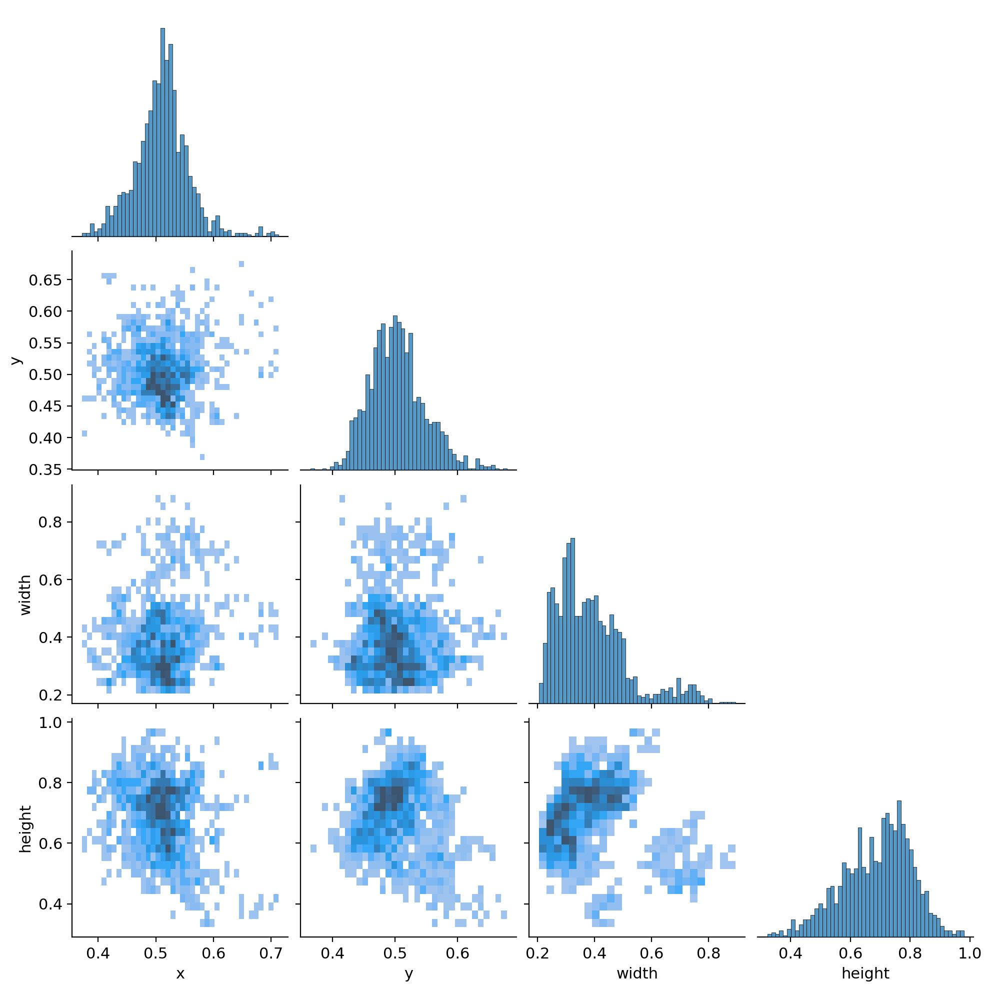

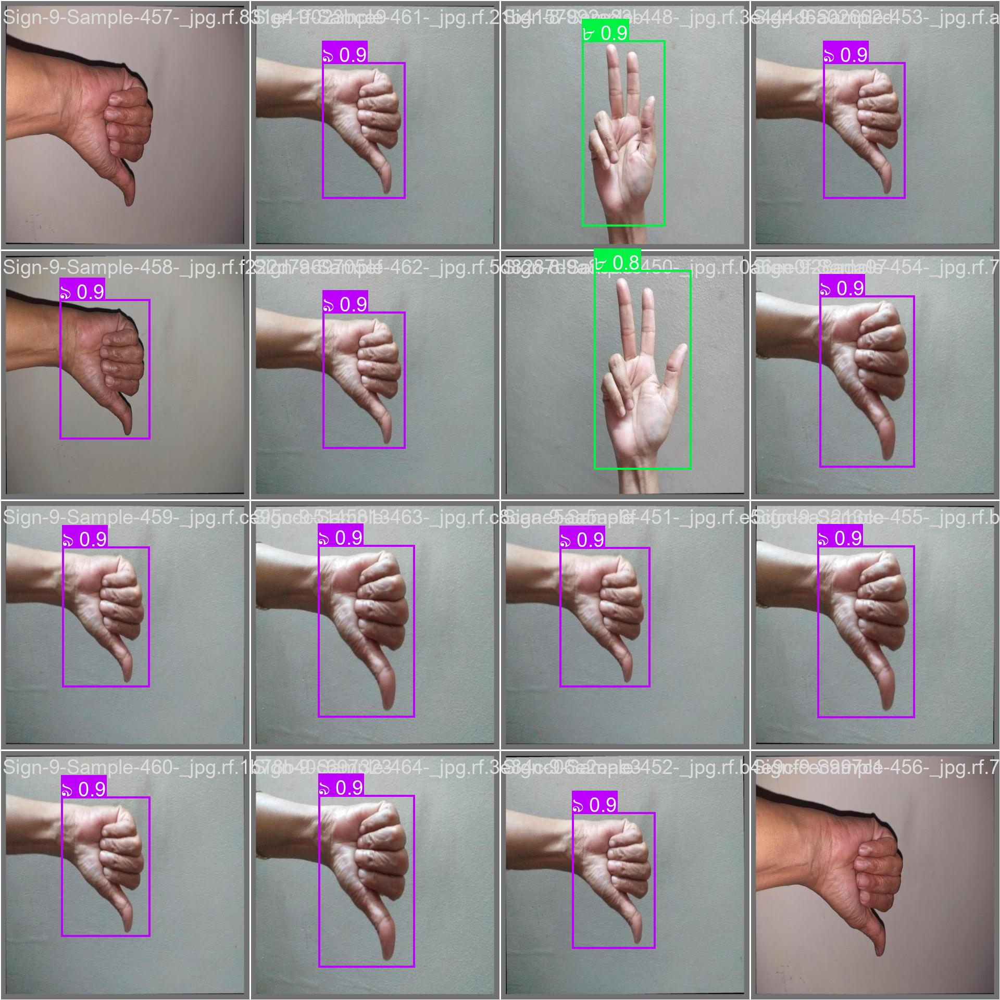

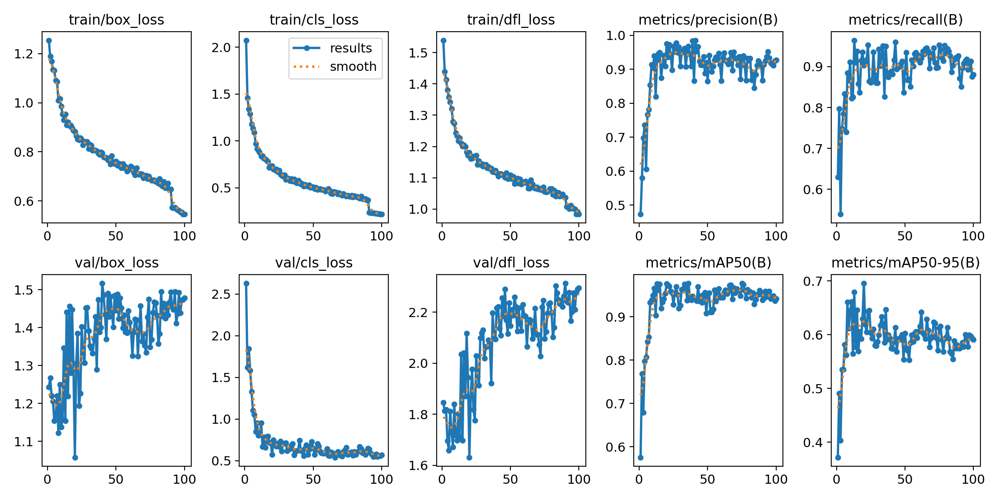

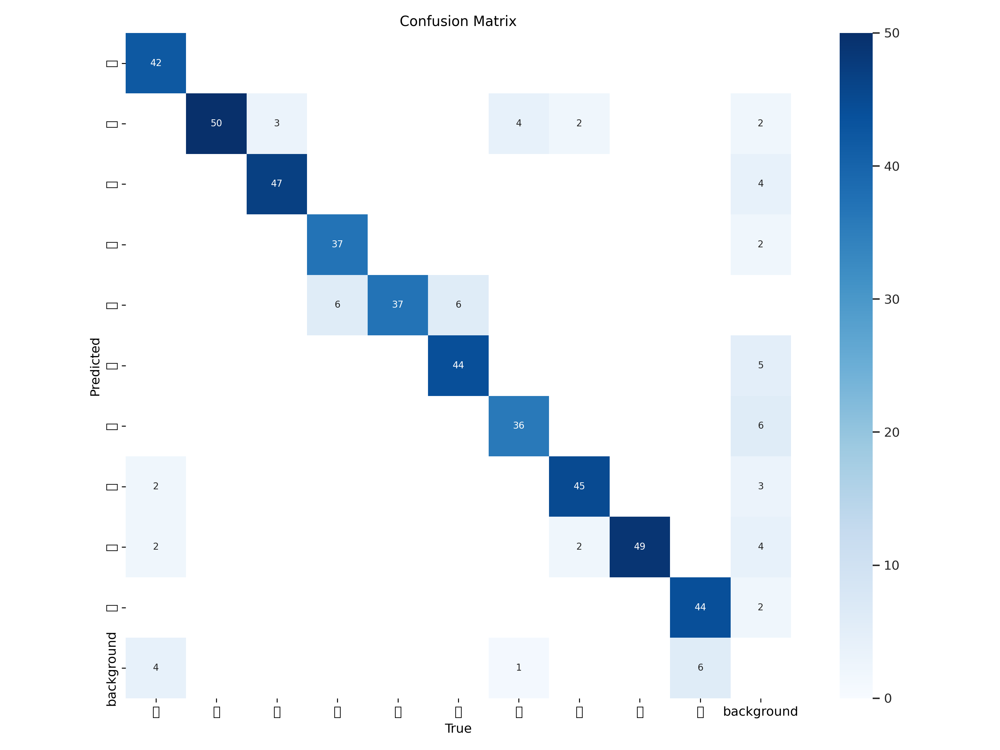

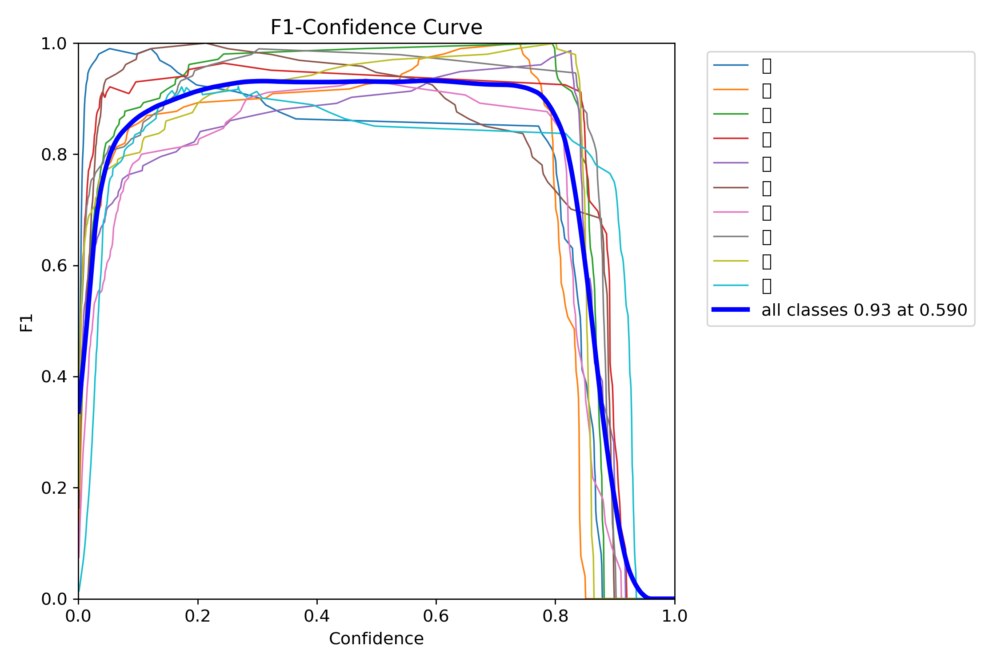

...

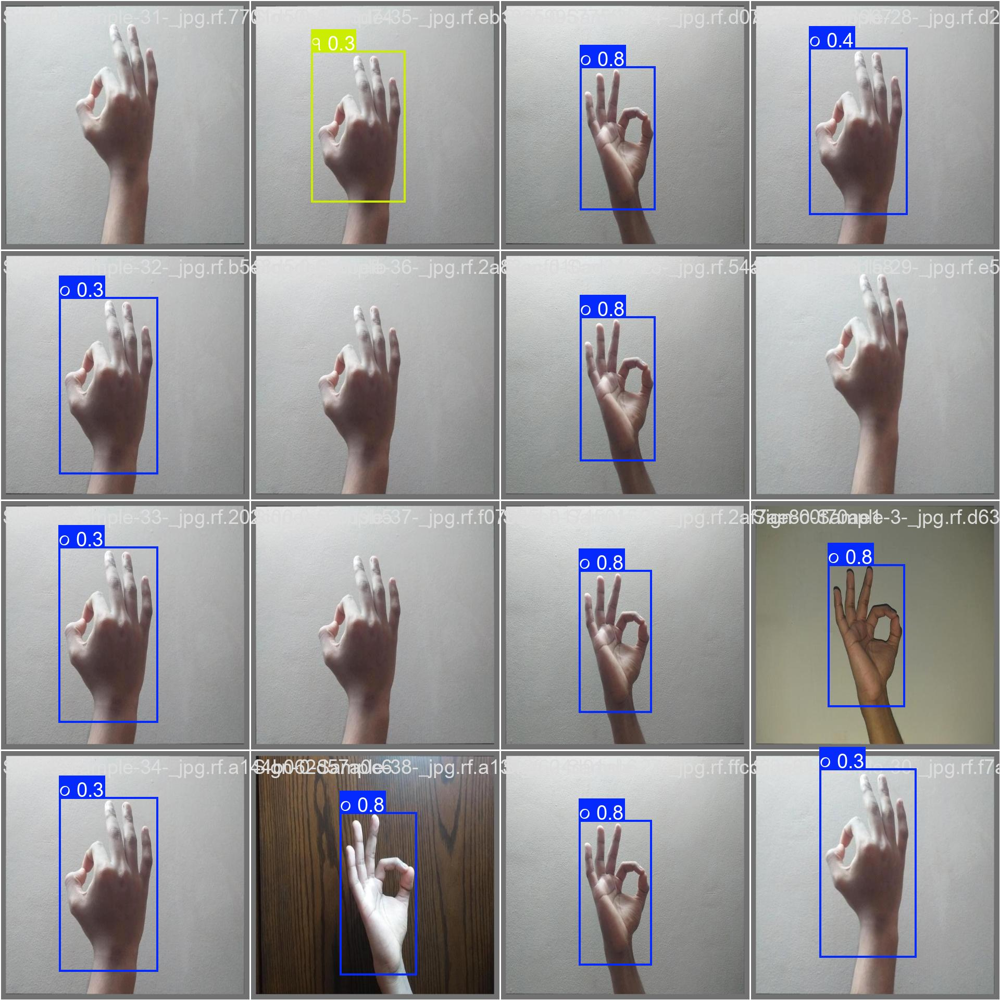

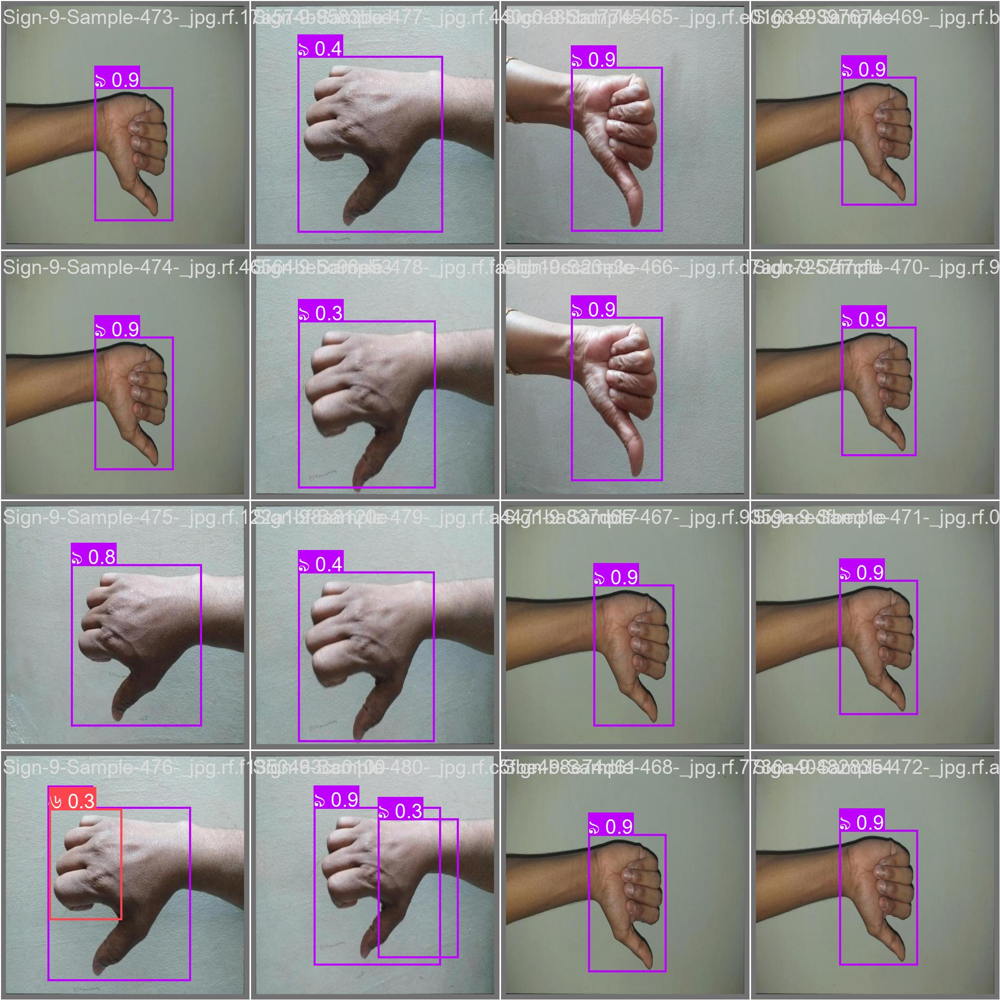

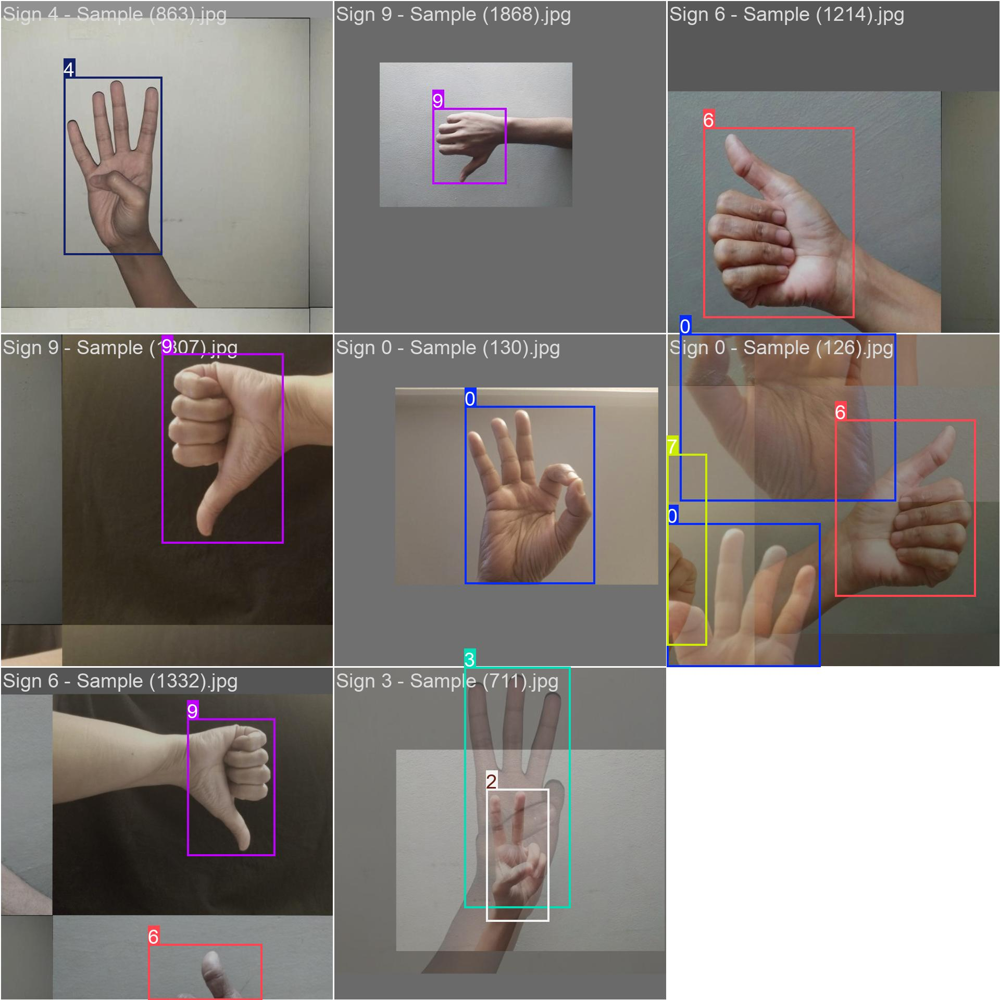

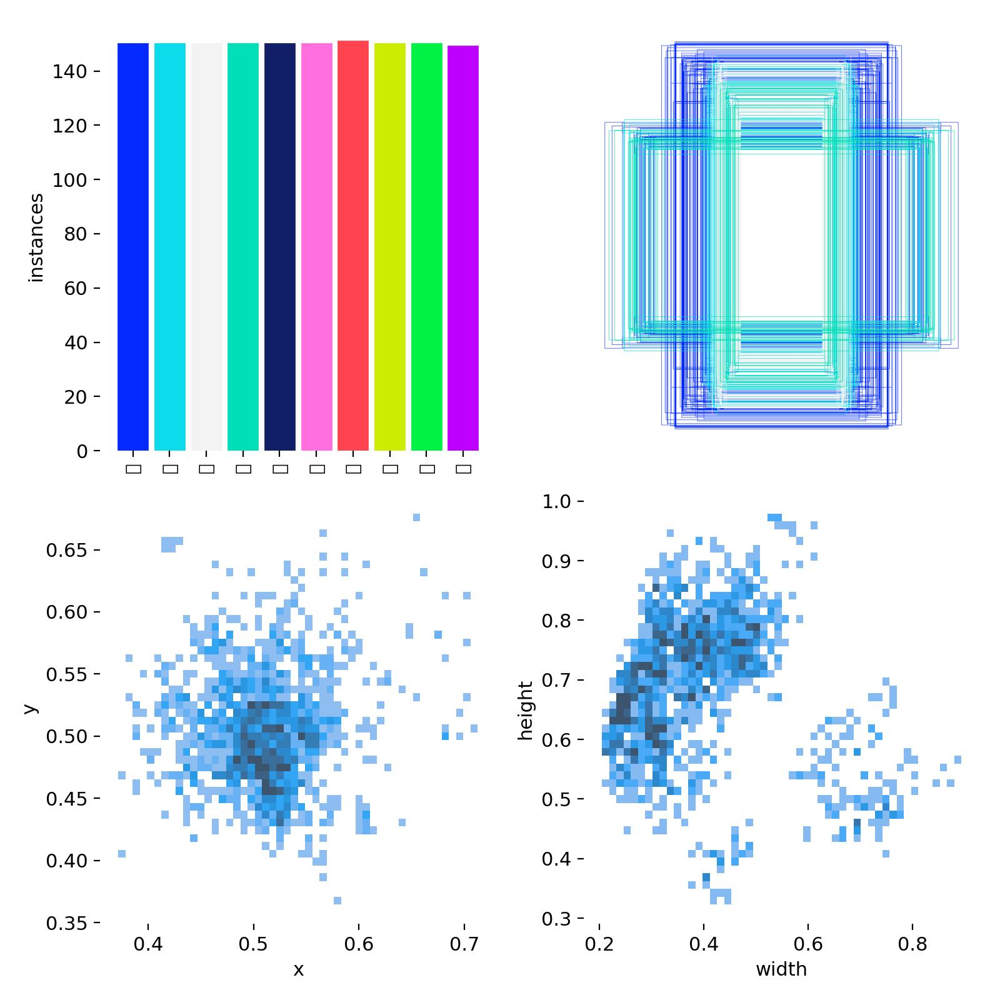

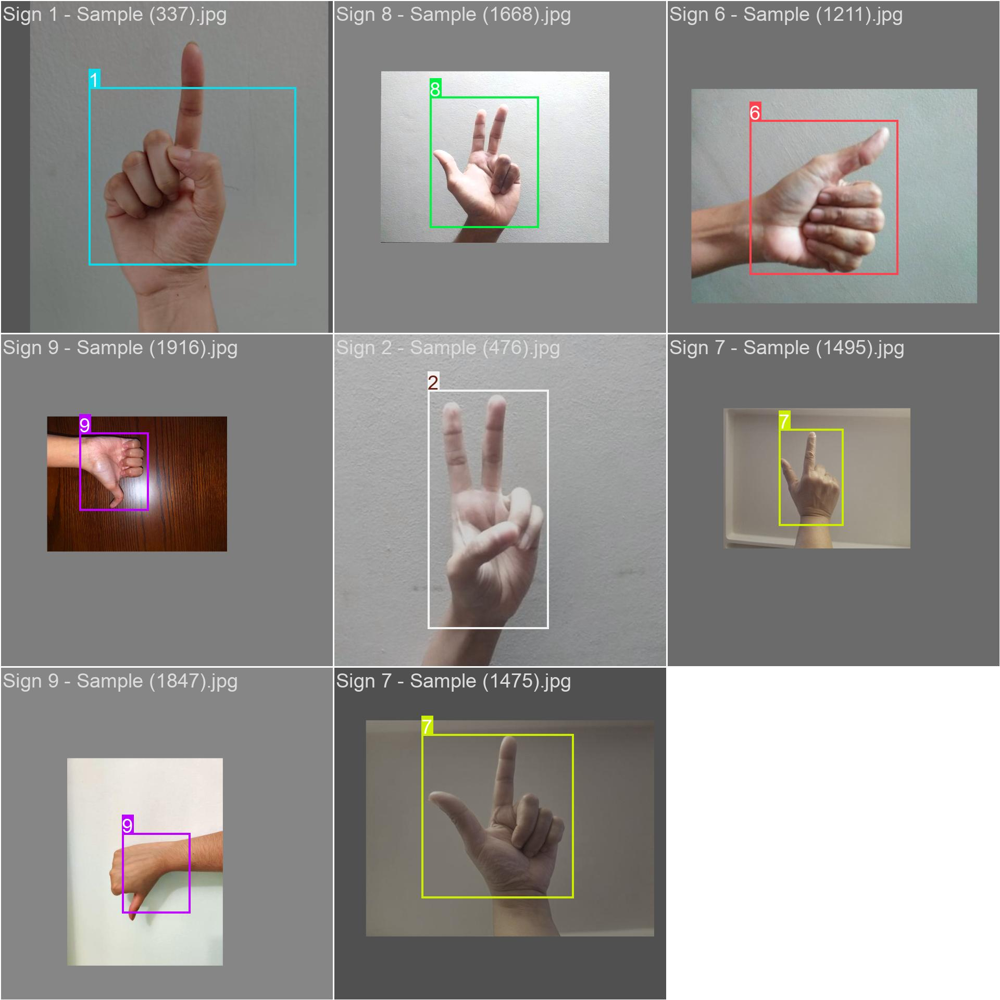

In [7]:
import os
from IPython.display import Image, display

path='/kaggle/working/runs/detect/train'
image=[f for f in os.listdir(path) if f.endswith('.jpg') or f.endswith('.png')]

for i in range(len(image)):
    display(Image(filename=path+'/'+image[i]))

In [8]:
from ultralytics import YOLO

# Load the trained model
model = YOLO("/kaggle/working/runs/detect/train/weights/best.pt")

# Validate the model
results = model.val()

# Access metrics correctly
map50 = results.box.map50  # mAP@0.5
map5095 = results.box.map  # mAP@0.5:0.95

print(f"mAP@0.5: {map50:.2f}%")
print(f"mAP@0.5:0.95: {map5095:.2f}%")

Ultralytics 8.3.85 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
Model summary (fused): 92 layers, 25,845,550 parameters, 0 gradients, 78.7 GFLOPs


val: Scanning /kaggle/input/numerical-one-hand-sign/Data Sign lanuage/valid/labels... 468 images, 0 backgrounds, 0 corrupt: 100%|██████████| 468/468 [00:00<00:00, 679.71it/s]

val: WARNING ⚠️ Cache directory /kaggle/input/numerical-one-hand-sign/Data Sign lanuage/valid is not writeable, cache not saved.



                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:07<00:00,  4.11it/s]
/usr/local/lib/python3.10/dist-packages/ultralytics/utils/metrics.py:474: UserWarning: Glyph 2534 (\N{BENGALI DIGIT ZERO}) missing from current font.
  fig.savefig(save_dir, dpi=250)
/usr/local/lib/python3.10/dist-packages/ultralytics/utils/metrics.py:474: UserWarning: Matplotlib currently does not support Bengali natively.
  fig.savefig(save_dir, dpi=250)
/usr/local/lib/python3.10/dist-packages/ultralytics/utils/metrics.py:474: UserWarning: Glyph 2535 (\N{BENGALI DIGIT ONE}) missing from current font.
  fig.savefig(save_dir, dpi=250)
/usr/local/lib/python3.10/dist-packages/ultralytics/utils/metrics.py:474: UserWarning: Glyph 2536 (\N{BENGALI DIGIT TWO}) missing from current font.
  fig.savefig(save_dir, dpi=250)
/usr/local/lib/python3.10/dist-packages/ultralytics/utils/metrics.py:474: UserWarning: Glyph 2537 (\N{BENGALI DIGIT THREE}) missing from c

                   all        468        469      0.975      0.903      0.976      0.697
                     ০         50         50          1      0.749      0.995      0.723
                     ১         50         50      0.949          1      0.995      0.708
                     ২         50         50      0.987          1      0.995      0.741
                     ৩         43         43          1      0.882      0.972       0.72
                     ৪         37         37      0.867          1      0.979      0.611
                     ৫         50         50          1      0.866      0.995      0.553
                     ৬         40         41          1      0.845      0.903      0.625
                     ৭         49         49          1      0.949      0.989      0.808
                     ৮         49         49      0.949          1      0.995      0.846
                     ৯         50         50          1      0.735      0.947      0.639


/usr/local/lib/python3.10/dist-packages/ultralytics/utils/metrics.py:436: UserWarning: Glyph 2534 (\N{BENGALI DIGIT ZERO}) missing from current font.
  fig.savefig(plot_fname, dpi=250)
/usr/local/lib/python3.10/dist-packages/ultralytics/utils/metrics.py:436: UserWarning: Matplotlib currently does not support Bengali natively.
  fig.savefig(plot_fname, dpi=250)
/usr/local/lib/python3.10/dist-packages/ultralytics/utils/metrics.py:436: UserWarning: Glyph 2535 (\N{BENGALI DIGIT ONE}) missing from current font.
  fig.savefig(plot_fname, dpi=250)
/usr/local/lib/python3.10/dist-packages/ultralytics/utils/metrics.py:436: UserWarning: Glyph 2536 (\N{BENGALI DIGIT TWO}) missing from current font.
  fig.savefig(plot_fname, dpi=250)
/usr/local/lib/python3.10/dist-packages/ultralytics/utils/metrics.py:436: UserWarning: Glyph 2537 (\N{BENGALI DIGIT THREE}) missing from current font.
  fig.savefig(plot_fname, dpi=250)
/usr/local/lib/python3.10/dist-packages/ultralytics/utils/metrics.py:436: UserWarni

Speed: 0.7ms preprocess, 10.8ms inference, 0.0ms loss, 0.8ms postprocess per image
Results saved to runs/detect/val
mAP@0.5: 0.98%
mAP@0.5:0.95: 0.70%


In [9]:
from ultralytics import YOLO

# Load the trained model
model = YOLO("/kaggle/working/runs/detect/train/weights/best.pt")

# Run validation and get results
results = model.val()

# Initialize dictionary to store metrics
class_accuracy = {}

# Per-class metrics
for i, class_name in enumerate(model.names.values()):
    precision, recall, map50, map5095 = results.box.class_result(i)  # Get metrics for class i
    class_accuracy[class_name] = {
        'Precision': precision * 100,  # Convert to percentage
        'Recall': recall * 100,
        'mAP50': map50 * 100,
        'mAP50-95': map5095 * 100
    }

# Print overall metrics
print("Overall Model Performance:")
print(f"mAP50: {results.box.map50 * 100:.2f}%")
print(f"mAP50-95: {results.box.map * 100:.2f}%")
print(f"Overall Precision: {results.box.mp * 100:.2f}%")
print(f"Overall Recall: {results.box.mr * 100:.2f}%")

# Print per-class metrics
print("\nPer-class Performance:")
for class_name, metrics in class_accuracy.items():
    print(f"\n{class_name}:")
    for metric_name, value in metrics.items():
        print(f"{metric_name}: {value:.2f}%")

Ultralytics 8.3.85 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
Model summary (fused): 92 layers, 25,845,550 parameters, 0 gradients, 78.7 GFLOPs


val: Scanning /kaggle/input/numerical-one-hand-sign/Data Sign lanuage/valid/labels... 468 images, 0 backgrounds, 0 corrupt: 100%|██████████| 468/468 [00:00<00:00, 925.79it/s]


val: WARNING ⚠️ Cache directory /kaggle/input/numerical-one-hand-sign/Data Sign lanuage/valid is not writeable, cache not saved.


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 30/30 [00:07<00:00,  4.12it/s]
/usr/local/lib/python3.10/dist-packages/ultralytics/utils/metrics.py:474: UserWarning: Glyph 2534 (\N{BENGALI DIGIT ZERO}) missing from current font.
  fig.savefig(save_dir, dpi=250)
/usr/local/lib/python3.10/dist-packages/ultralytics/utils/metrics.py:474: UserWarning: Matplotlib currently does not support Bengali natively.
  fig.savefig(save_dir, dpi=250)
/usr/local/lib/python3.10/dist-packages/ultralytics/utils/metrics.py:474: UserWarning: Glyph 2535 (\N{BENGALI DIGIT ONE}) missing from current font.
  fig.savefig(save_dir, dpi=250)
/usr/local/lib/python3.10/dist-packages/ultralytics/utils/metrics.py:474: UserWarning: Glyph 2536 (\N{BENGALI DIGIT TWO}) missing from current font.
  fig.savefig(save_dir, dpi=250)
/usr/local/lib/python3.10/dist-packages/ultralytics/utils/metrics.py:474: UserWarning: Glyph 2537 (\N{BENGALI DIGIT THREE}) missing from cu

                   all        468        469      0.975      0.903      0.976      0.697
                     ০         50         50          1      0.749      0.995      0.723
                     ১         50         50      0.949          1      0.995      0.708
                     ২         50         50      0.987          1      0.995      0.741
                     ৩         43         43          1      0.882      0.972       0.72
                     ৪         37         37      0.867          1      0.979      0.611
                     ৫         50         50          1      0.866      0.995      0.553
                     ৬         40         41          1      0.845      0.903      0.625
                     ৭         49         49          1      0.949      0.989      0.808
                     ৮         49         49      0.949          1      0.995      0.846
                     ৯         50         50          1      0.735      0.947      0.639


/usr/local/lib/python3.10/dist-packages/ultralytics/utils/metrics.py:436: UserWarning: Glyph 2534 (\N{BENGALI DIGIT ZERO}) missing from current font.
  fig.savefig(plot_fname, dpi=250)
/usr/local/lib/python3.10/dist-packages/ultralytics/utils/metrics.py:436: UserWarning: Matplotlib currently does not support Bengali natively.
  fig.savefig(plot_fname, dpi=250)
/usr/local/lib/python3.10/dist-packages/ultralytics/utils/metrics.py:436: UserWarning: Glyph 2535 (\N{BENGALI DIGIT ONE}) missing from current font.
  fig.savefig(plot_fname, dpi=250)
/usr/local/lib/python3.10/dist-packages/ultralytics/utils/metrics.py:436: UserWarning: Glyph 2536 (\N{BENGALI DIGIT TWO}) missing from current font.
  fig.savefig(plot_fname, dpi=250)
/usr/local/lib/python3.10/dist-packages/ultralytics/utils/metrics.py:436: UserWarning: Glyph 2537 (\N{BENGALI DIGIT THREE}) missing from current font.
  fig.savefig(plot_fname, dpi=250)
/usr/local/lib/python3.10/dist-packages/ultralytics/utils/metrics.py:436: UserWarni

Speed: 0.8ms preprocess, 10.8ms inference, 0.0ms loss, 0.7ms postprocess per image
Results saved to runs/detect/val2
Overall Model Performance:
mAP50: 97.65%
mAP50-95: 69.75%
Overall Precision: 97.53%
Overall Recall: 90.25%

Per-class Performance:

০:
Precision: 100.00%
Recall: 74.92%
mAP50: 99.46%
mAP50-95: 72.28%

১:
Precision: 94.95%
Recall: 100.00%
mAP50: 99.50%
mAP50-95: 70.85%

২:
Precision: 98.72%
Recall: 100.00%
mAP50: 99.50%
mAP50-95: 74.12%

৩:
Precision: 100.00%
Recall: 88.19%
mAP50: 97.20%
mAP50-95: 71.98%

৪:
Precision: 86.68%
Recall: 100.00%
mAP50: 97.95%
mAP50-95: 61.14%

৫:
Precision: 100.00%
Recall: 86.56%
mAP50: 99.50%
mAP50-95: 55.32%

৬:
Precision: 100.00%
Recall: 84.46%
mAP50: 90.26%
mAP50-95: 62.46%

৭:
Precision: 100.00%
Recall: 94.94%
mAP50: 98.88%
mAP50-95: 80.82%

৮:
Precision: 94.92%
Recall: 100.00%
mAP50: 99.50%
mAP50-95: 84.60%

৯:
Precision: 100.00%
Recall: 73.45%
mAP50: 94.74%
mAP50-95: 63.90%



image 1/1 /kaggle/input/numerical-one-hand-sign/Data Sign lanuage/valid/images/Sign-0-Sample-15-_jpg.rf.e7ef5773d3778fb5795d5bf29510776e.jpg: 640x640 1 ০, 14.8ms
Speed: 2.0ms preprocess, 14.8ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


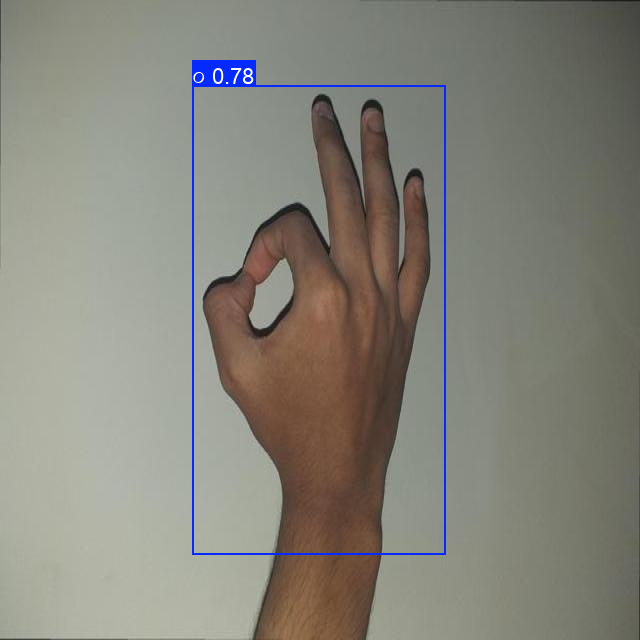

In [10]:
model = YOLO("/kaggle/working/runs/detect/train/weights/best.pt")  

results = model.predict("/kaggle/input/numerical-one-hand-sign/Data Sign lanuage/valid/images/Sign-0-Sample-15-_jpg.rf.e7ef5773d3778fb5795d5bf29510776e.jpg")

results[0].show()


image 1/1 /kaggle/input/numerical-one-hand-sign/Data Sign lanuage/valid/images/Sign-1-Sample-54-_jpg.rf.0e4a2eee0ea2ebaba29c6779c153f51f.jpg: 640x640 1 ১, 14.8ms
Speed: 1.5ms preprocess, 14.8ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


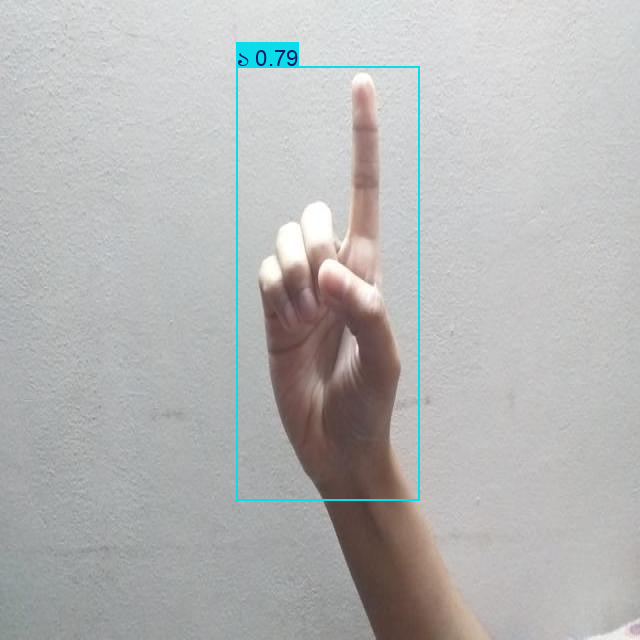

In [11]:
model = YOLO("/kaggle/working/runs/detect/train/weights/best.pt")  

results = model.predict("/kaggle/input/numerical-one-hand-sign/Data Sign lanuage/valid/images/Sign-1-Sample-54-_jpg.rf.0e4a2eee0ea2ebaba29c6779c153f51f.jpg")

results[0].show()


image 1/1 /kaggle/input/numerical-one-hand-sign/Data Sign lanuage/valid/images/Sign-2-Sample-101-_jpg.rf.afdc47bbc0c75043175513e23f8f7eb0.jpg: 640x640 1 ২, 16.3ms
Speed: 1.3ms preprocess, 16.3ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


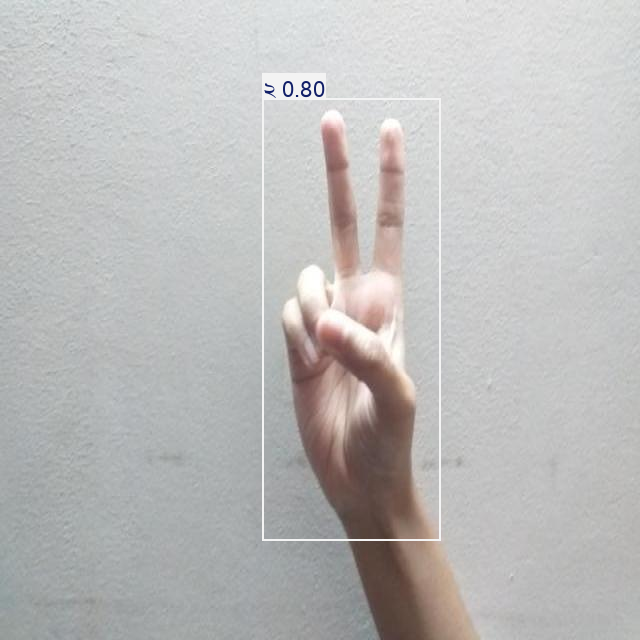

In [12]:
model = YOLO("/kaggle/working/runs/detect/train/weights/best.pt")  

results = model.predict("/kaggle/input/numerical-one-hand-sign/Data Sign lanuage/valid/images/Sign-2-Sample-101-_jpg.rf.afdc47bbc0c75043175513e23f8f7eb0.jpg")

results[0].show()


image 1/1 /kaggle/input/numerical-one-hand-sign/Data Sign lanuage/valid/images/Sign-3-Sample-166-_jpg.rf.cddf2a3b3e3dd4f96bd4b23127e61de6.jpg: 640x640 1 ৩, 16.3ms
Speed: 1.6ms preprocess, 16.3ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


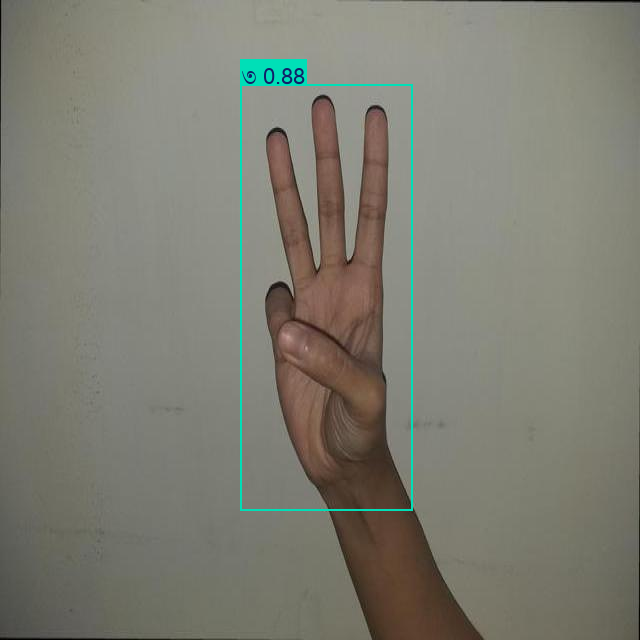

In [13]:
model = YOLO("/kaggle/working/runs/detect/train/weights/best.pt")  

results = model.predict("/kaggle/input/numerical-one-hand-sign/Data Sign lanuage/valid/images/Sign-3-Sample-166-_jpg.rf.cddf2a3b3e3dd4f96bd4b23127e61de6.jpg")

results[0].show()


image 1/1 /kaggle/input/numerical-one-hand-sign/Data Sign lanuage/valid/images/Sign-4-Sample-217-_jpg.rf.e125b9401e22244a52bdcbaa8d1c8d75.jpg: 640x640 1 ৪, 16.4ms
Speed: 1.5ms preprocess, 16.4ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


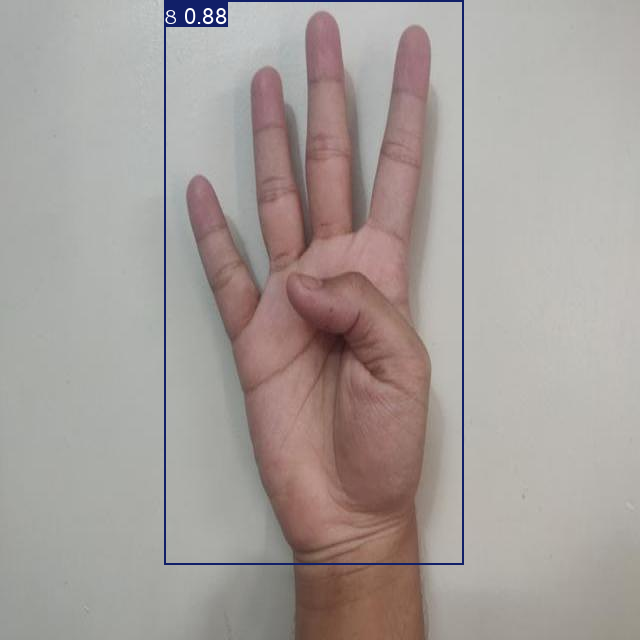

In [14]:
model = YOLO("/kaggle/working/runs/detect/train/weights/best.pt")  

results = model.predict("/kaggle/input/numerical-one-hand-sign/Data Sign lanuage/valid/images/Sign-4-Sample-217-_jpg.rf.e125b9401e22244a52bdcbaa8d1c8d75.jpg")

results[0].show()


image 1/1 /kaggle/input/numerical-one-hand-sign/Data Sign lanuage/valid/images/Sign-5-Sample-259-_jpg.rf.395bb9cc83c036250727627594fb0282.jpg: 640x640 1 ৫, 16.3ms
Speed: 1.6ms preprocess, 16.3ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


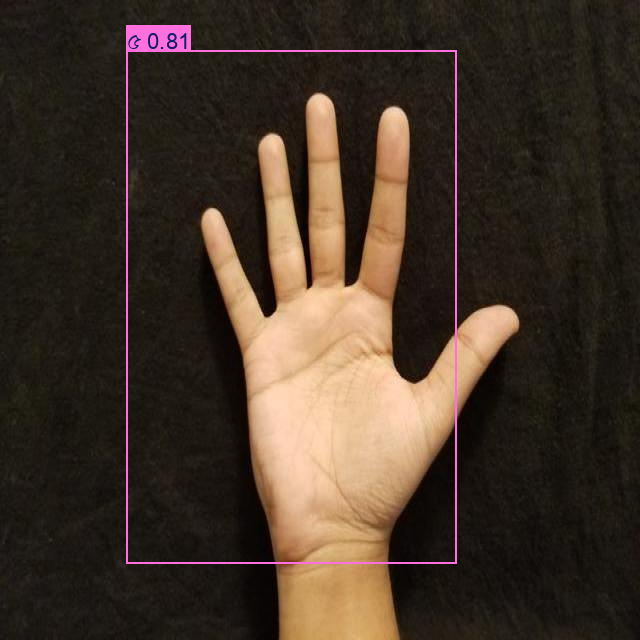

In [15]:
model = YOLO("/kaggle/working/runs/detect/train/weights/best.pt")  

results = model.predict("/kaggle/input/numerical-one-hand-sign/Data Sign lanuage/valid/images/Sign-5-Sample-259-_jpg.rf.395bb9cc83c036250727627594fb0282.jpg")

results[0].show()


image 1/1 /kaggle/input/numerical-one-hand-sign/Data Sign lanuage/valid/images/Sign-6-Sample-322-_jpg.rf.65baaa1617984e79e39b86349c80b6ed.jpg: 640x640 1 ৬, 16.3ms
Speed: 1.5ms preprocess, 16.3ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


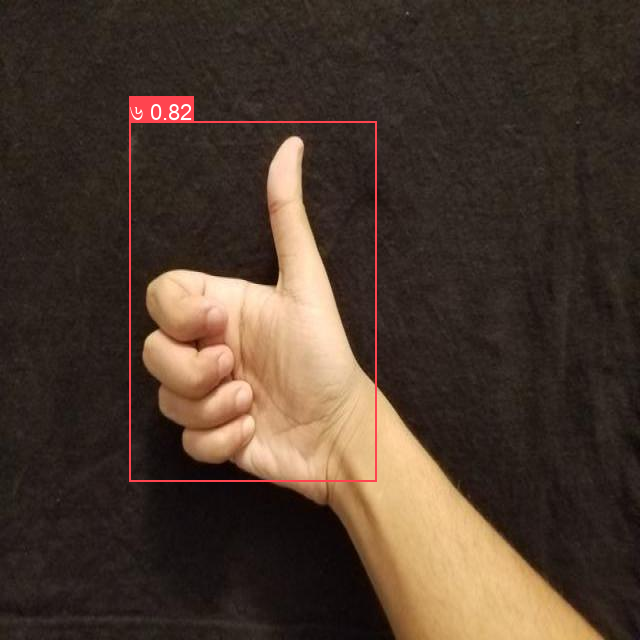

In [16]:
model = YOLO("/kaggle/working/runs/detect/train/weights/best.pt")  

results = model.predict("/kaggle/input/numerical-one-hand-sign/Data Sign lanuage/valid/images/Sign-6-Sample-322-_jpg.rf.65baaa1617984e79e39b86349c80b6ed.jpg")

results[0].show()


image 1/1 /kaggle/input/numerical-one-hand-sign/Data Sign lanuage/valid/images/Sign-7-Sample-358-_jpg.rf.2026000141ecf85c0560cf1cd3d2f0f5.jpg: 640x640 1 ৭, 16.3ms
Speed: 1.5ms preprocess, 16.3ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


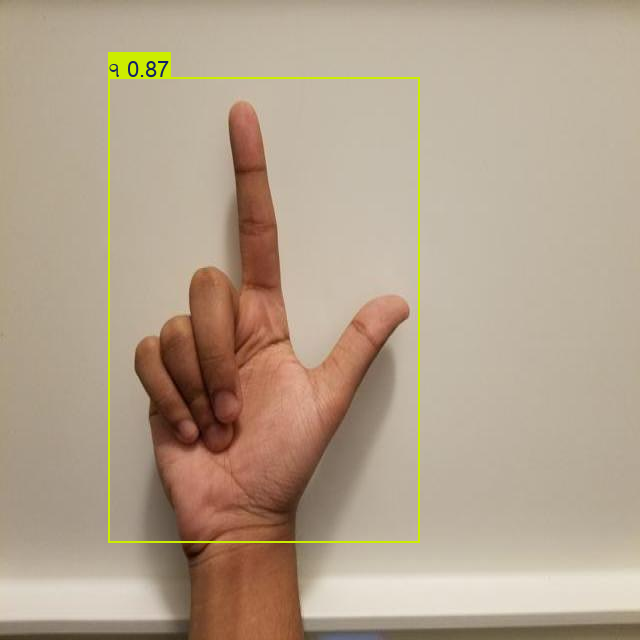

In [17]:
model = YOLO("/kaggle/working/runs/detect/train/weights/best.pt")  

results = model.predict("/kaggle/input/numerical-one-hand-sign/Data Sign lanuage/valid/images/Sign-7-Sample-358-_jpg.rf.2026000141ecf85c0560cf1cd3d2f0f5.jpg")

results[0].show()


image 1/1 /kaggle/input/numerical-one-hand-sign/Data Sign lanuage/valid/images/Sign-8-Sample-432-_jpg.rf.c34c51e27d8f80fe392ac0a63aaec03e.jpg: 640x640 1 ৮, 16.3ms
Speed: 1.5ms preprocess, 16.3ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


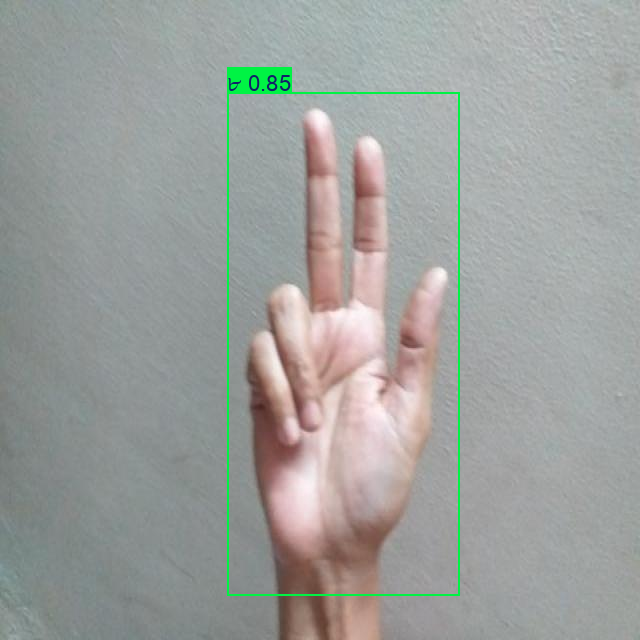

In [18]:
model = YOLO("/kaggle/working/runs/detect/train/weights/best.pt")  

results = model.predict("/kaggle/input/numerical-one-hand-sign/Data Sign lanuage/valid/images/Sign-8-Sample-432-_jpg.rf.c34c51e27d8f80fe392ac0a63aaec03e.jpg")

results[0].show()


image 1/1 /kaggle/input/numerical-one-hand-sign/Data Sign lanuage/valid/images/Sign-9-Sample-466-_jpg.rf.d7adc7257f7cfde54cc0e6a53491d125.jpg: 640x640 1 ৯, 16.2ms
Speed: 1.4ms preprocess, 16.2ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


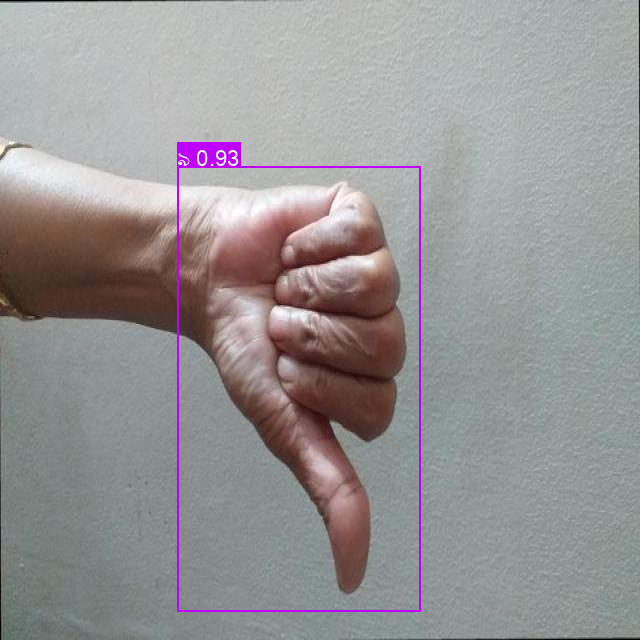

In [19]:
model = YOLO("/kaggle/working/runs/detect/train/weights/best.pt")  

results = model.predict("/kaggle/input/numerical-one-hand-sign/Data Sign lanuage/valid/images/Sign-9-Sample-466-_jpg.rf.d7adc7257f7cfde54cc0e6a53491d125.jpg")

results[0].show()


image 1/1 /kaggle/input/numerical-one-hand-sign/Data Sign lanuage/valid/images/Sign-9-Sample-472-_jpg.rf.a1f3a0c664d590a0822365100d4f8002.jpg: 640x640 1 ৯, 16.3ms
Speed: 1.4ms preprocess, 16.3ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


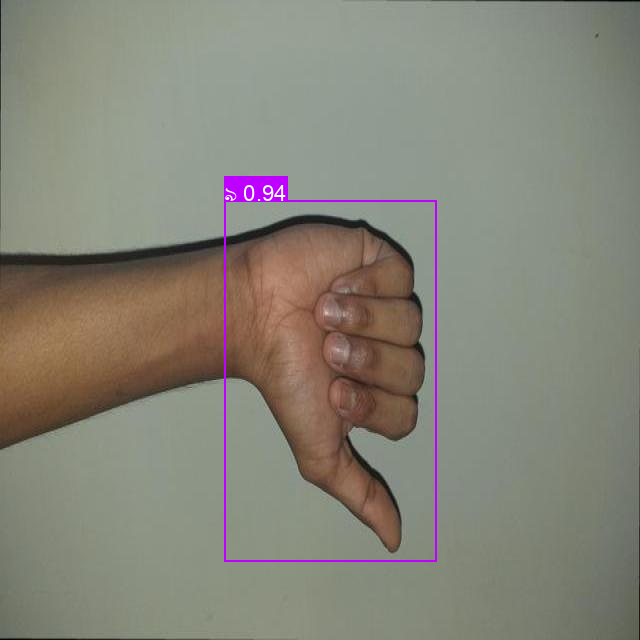

In [20]:
model = YOLO("/kaggle/working/runs/detect/train/weights/best.pt")  

results = model.predict("/kaggle/input/numerical-one-hand-sign/Data Sign lanuage/valid/images/Sign-9-Sample-472-_jpg.rf.a1f3a0c664d590a0822365100d4f8002.jpg")

results[0].show()

In [21]:
!pip install matplotlib pandas seaborn

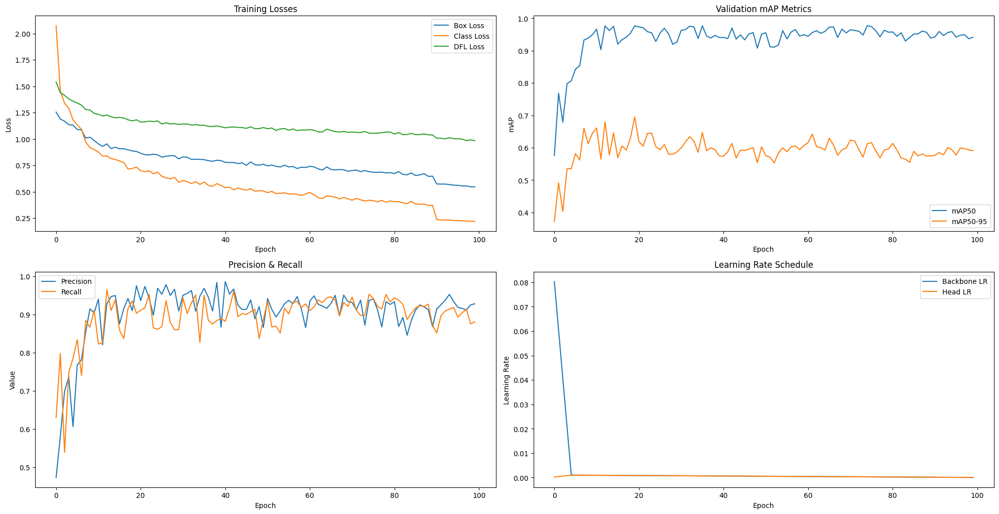

In [22]:
import matplotlib.pyplot as plt
import pandas as pd
from ultralytics import YOLO
import os
import seaborn as sns
from IPython.display import Image

# ============================
# 1. Training Metrics Visualization
# ============================
# Load training results
results_path = "/kaggle/working/runs/detect/train/results.csv"
results = pd.read_csv(results_path)

# Set up plots
plt.figure(figsize=(20, 15))

# Plot training losses
plt.subplot(3, 2, 1)
plt.plot(results['train/box_loss'], label='Box Loss')
plt.plot(results['train/cls_loss'], label='Class Loss')
plt.plot(results['train/dfl_loss'], label='DFL Loss')
plt.title('Training Losses')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend()

# Plot validation metrics
plt.subplot(3, 2, 2)
plt.plot(results['metrics/mAP50(B)'], label='mAP50')
plt.plot(results['metrics/mAP50-95(B)'], label='mAP50-95')
plt.title('Validation mAP Metrics')
plt.ylabel('mAP')
plt.xlabel('Epoch')
plt.legend()

# Plot precision and recall
plt.subplot(3, 2, 3)
plt.plot(results['metrics/precision(B)'], label='Precision')
plt.plot(results['metrics/recall(B)'], label='Recall')
plt.title('Precision & Recall')
plt.ylabel('Value')
plt.xlabel('Epoch')
plt.legend()

# Plot learning rate
plt.subplot(3, 2, 4)
plt.plot(results['lr/pg0'], label='Backbone LR')
plt.plot(results['lr/pg1'], label='Head LR')
plt.title('Learning Rate Schedule')
plt.ylabel('Learning Rate')
plt.xlabel('Epoch')
plt.legend()

plt.tight_layout()
plt.show()

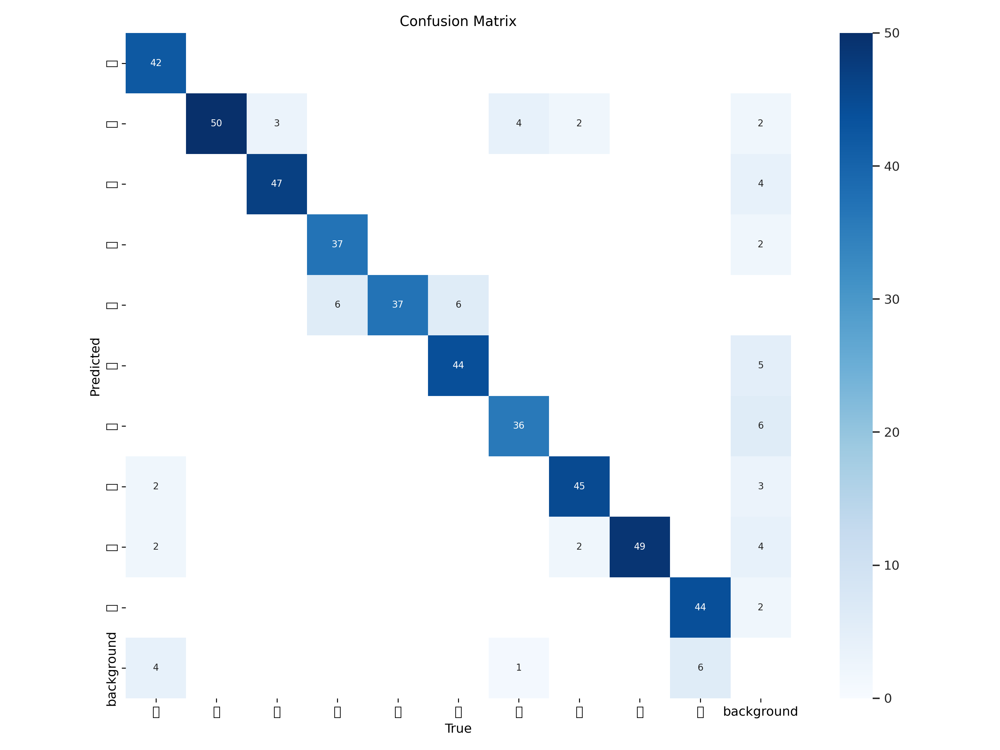

In [23]:
from PIL import Image
import os
from IPython.display import display
from ultralytics import YOLO

# Load best model
model = YOLO('/kaggle/working/runs/detect/train/weights/best.pt')

# Generate confusion matrix
confusion_matrix_path = '/kaggle/working/runs/detect/train/confusion_matrix.png'
if not os.path.exists(confusion_matrix_path):
    model.val(confusion_matrix=True)

# Display the image in Kaggle Notebook
if os.path.exists(confusion_matrix_path):
    img = Image.open(confusion_matrix_path)
    display(img)  # Correct way to display images in Kaggle
else:
    print("Confusion matrix image not found.")



image 1/1 /kaggle/input/numerical-one-hand-sign/Data Sign lanuage/valid/images/Sign-0-Sample-41-_jpg.rf.5a1fe2282978f25dfecb95c4add63810.jpg: 640x640 1 ০, 16.1ms
Speed: 1.7ms preprocess, 16.1ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)


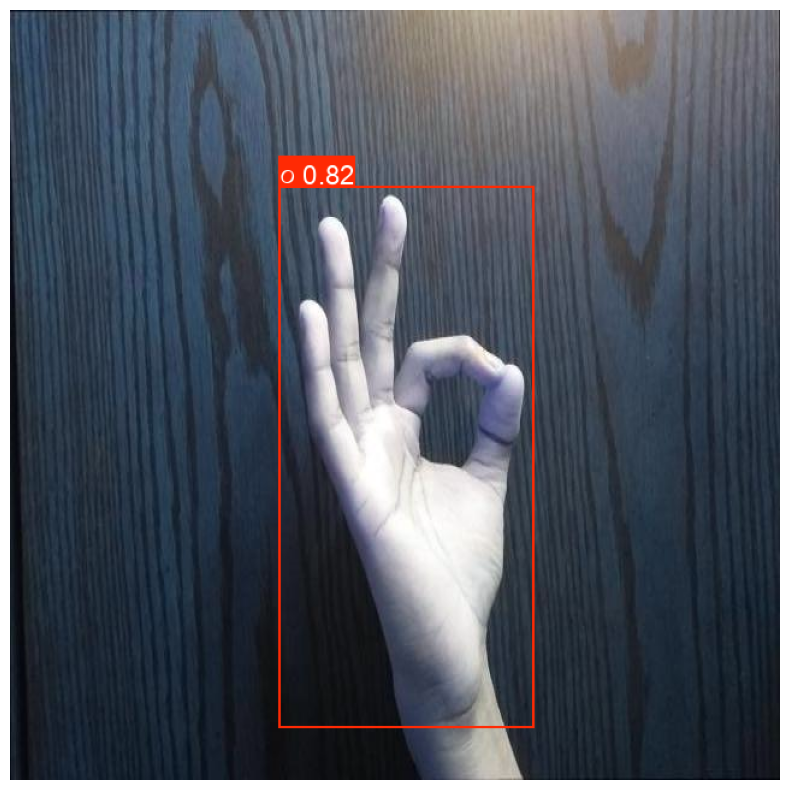


image 1/1 /kaggle/input/numerical-one-hand-sign/Data Sign lanuage/valid/images/Sign-5-Sample-257-_jpg.rf.a3186b42b6d9acab107e9be1597b09ce.jpg: 640x640 1 ৫, 16.5ms
Speed: 1.7ms preprocess, 16.5ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


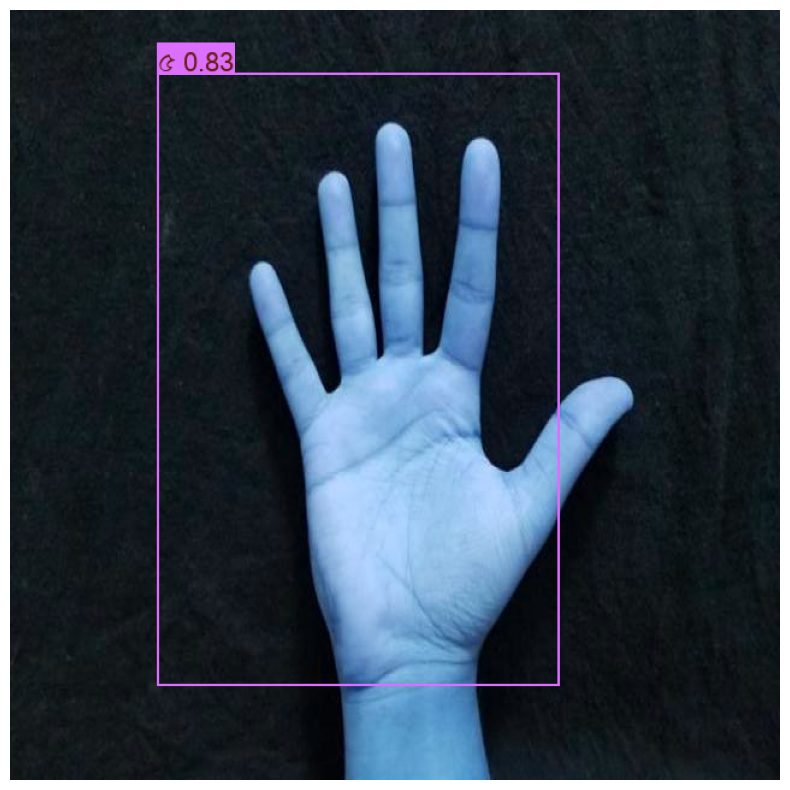


image 1/1 /kaggle/input/numerical-one-hand-sign/Data Sign lanuage/valid/images/Sign-0-Sample-50-_jpg.rf.fb0d109347e86c8a01d6e183beabae66.jpg: 640x640 1 ৮, 16.3ms
Speed: 1.9ms preprocess, 16.3ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


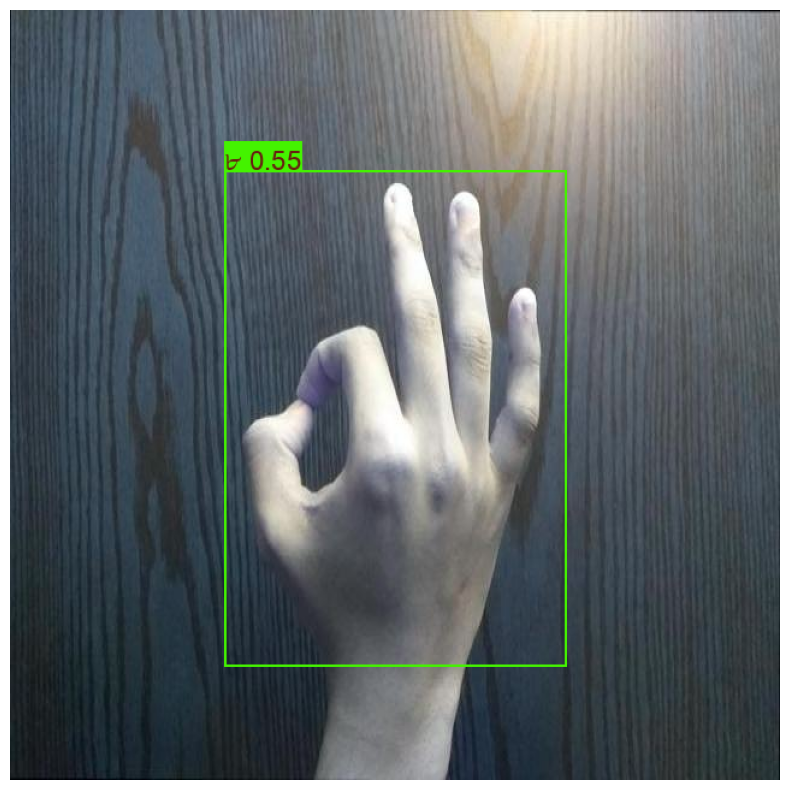


image 1/1 /kaggle/input/numerical-one-hand-sign/Data Sign lanuage/valid/images/Sign-9-Sample-470-_jpg.rf.9ce22b93df488e629307fe58124430f6.jpg: 640x640 1 ৯, 16.2ms
Speed: 1.9ms preprocess, 16.2ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)


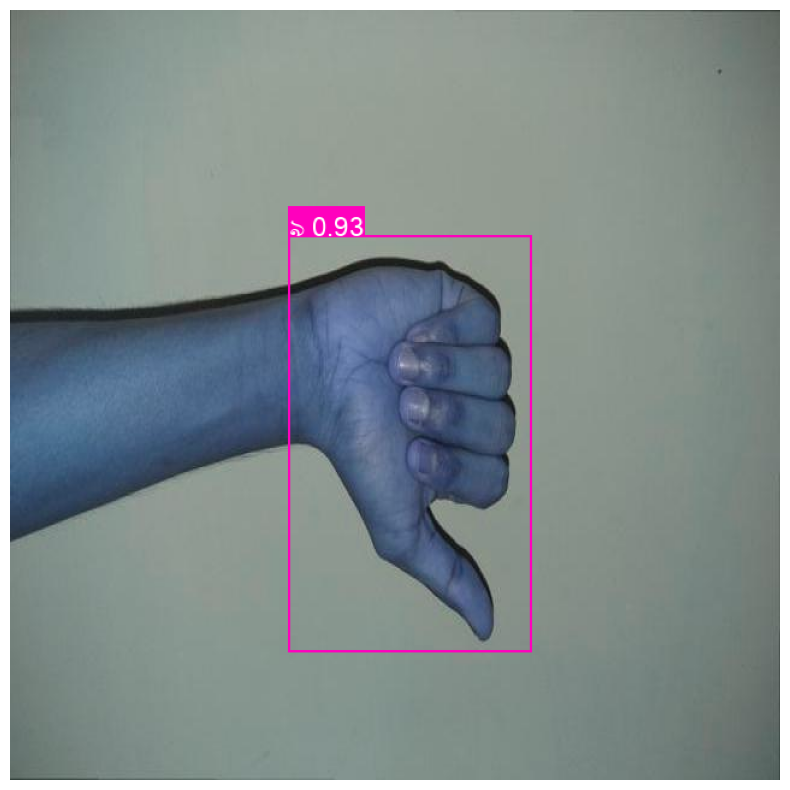


image 1/1 /kaggle/input/numerical-one-hand-sign/Data Sign lanuage/valid/images/Sign-6-Sample-337-_jpg.rf.d320a9b9183b21d961cefa83dfe635e7.jpg: 640x640 1 ৬, 16.3ms
Speed: 2.3ms preprocess, 16.3ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)


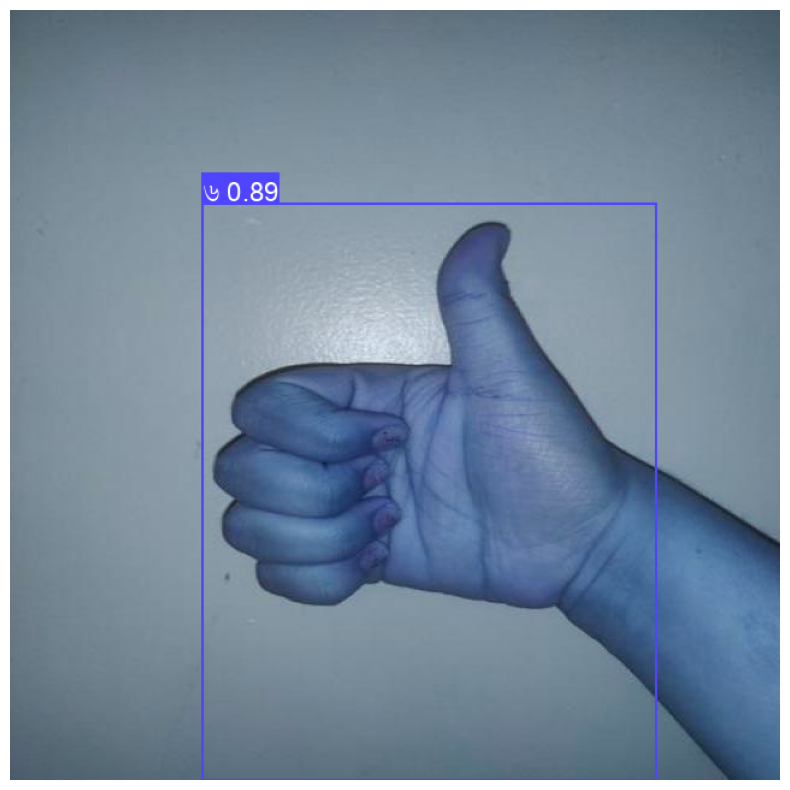

In [24]:
# ============================
# 3. Precision-Recall Curves
# ============================
pr_curve_path = '/kaggle/working/runs/detect/train/PR_curve.png'
if not os.path.exists(pr_curve_path):
    model.val()

Image.open(pr_curve_path)

# ============================
# 4. Sample Predictions Visualization
# ============================
# Get validation image paths
val_images_dir = "/kaggle/input/numerical-one-hand-sign/Data Sign lanuage/valid/images"
val_images = [os.path.join(val_images_dir, f) for f in os.listdir(val_images_dir)][:5]

# Generate predictions
for img_path in val_images:
    result = model.predict(img_path, conf=0.5)
    plotted = result[0].plot()
    plt.figure(figsize=(10, 10))
    plt.imshow(plotted)
    plt.axis('off')
    plt.show()

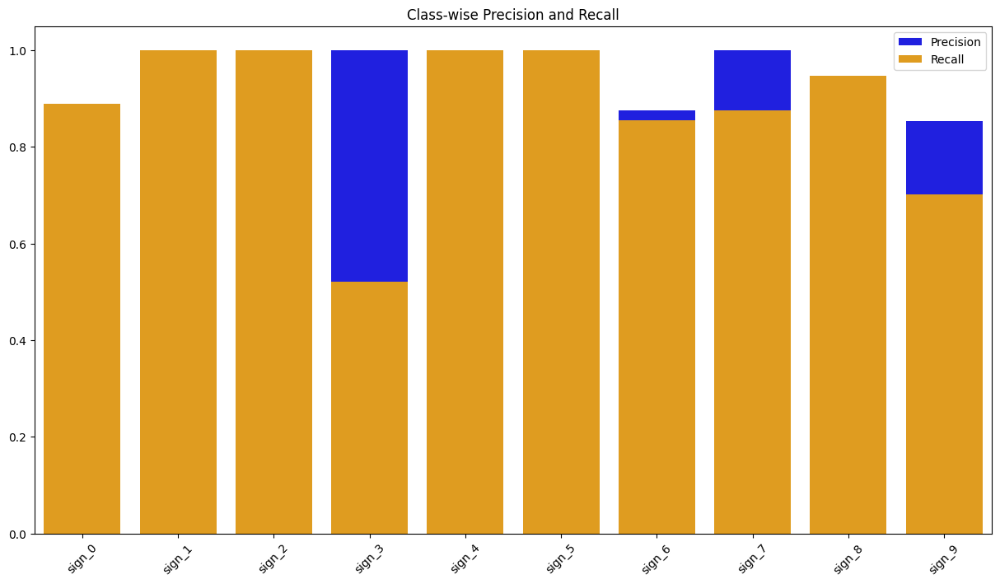

In [25]:
# ============================
# 5. Class-wise Performance
# ============================
class_metrics = {
    'Class': [f'sign_{i}' for i in range(10)],
    'Precision': [0.831, 0.816, 0.536, 1.0, 0.476, 0.988, 0.875, 1.0, 0.939, 0.854],
    'Recall': [0.89, 1.0, 1.0, 0.521, 1.0, 1.0, 0.856, 0.876, 0.948, 0.702]
}

plt.figure(figsize=(15, 8))
sns.barplot(x='Class', y='Precision', data=class_metrics, color='blue', label='Precision')
sns.barplot(x='Class', y='Recall', data=class_metrics, color='orange', label='Recall')
plt.title('Class-wise Precision and Recall')
plt.xticks(rotation=45)
plt.legend()
plt.show()

In [ ]:
import yaml

# Bangla numerals mapping
dataset_yaml = {
    "train": "/kaggle/input/numerical-one-hand-sign/Data Sign lanuage/train/images",
    "val": "/kaggle/input/numerical-one-hand-sign/Data Sign lanuage/valid/images",
    "nc": 10,  # Number of classes
    "names": {
        0: "০",  # Bangla 0
        1: "১",  # Bangla 1
        2: "২",  # Bangla 2
        3: "৩",  # Bangla 3
        4: "৪",  # Bangla 4
        5: "৫",  # Bangla 5
        6: "৬",  # Bangla 6
        7: "৭",  # Bangla 7
        8: "৮",  # Bangla 8
        9: "৯",  # Bangla 9
    }
}

# Save dataset.yaml with Bangla labels
with open('/kaggle/working/dataset.yaml', 'w', encoding='utf-8') as file:
    yaml.dump(dataset_yaml, file, allow_unicode=True)

print("✅ dataset.yaml updated with Bangla numerals!")


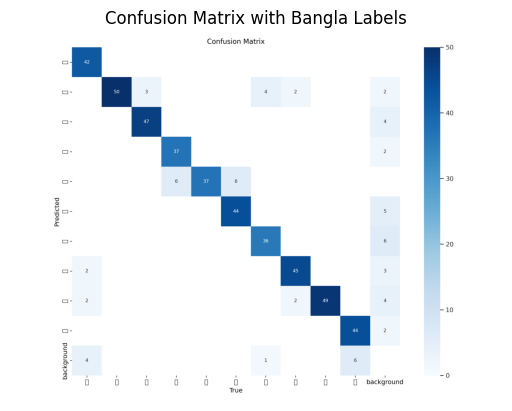

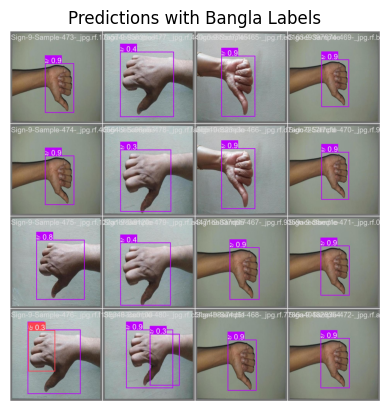

In [26]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import os
from PIL import Image

# Bangla numeral labels
bangla_labels = ["০", "১", "২", "৩", "৪", "৫", "৬", "৭", "৮", "৯"]

# Load the confusion matrix
conf_matrix_path = "runs/detect/train/confusion_matrix.png"

if os.path.exists(conf_matrix_path):
    # Load and visualize confusion matrix
    img = Image.open(conf_matrix_path)
    plt.imshow(img)
    plt.axis("off")
    plt.title("Confusion Matrix with Bangla Labels")
    plt.show()
else:
    print("⚠️ Confusion matrix not found!")

# Check predictions visualization
predictions_path = "runs/detect/train/val_batch0_pred.jpg"

if os.path.exists(predictions_path):
    img = Image.open(predictions_path)
    plt.imshow(img)
    plt.axis("off")
    plt.title("Predictions with Bangla Labels")
    plt.show()
else:
    print("⚠️ No validation predictions found!")


In [27]:
import os

# List files in the input directory
input_dir = '/kaggle/input/'
files = os.listdir(input_dir)
print(files)


['numerical-one-hand-sign']



image 1/1 /kaggle/input/numerical-one-hand-sign/Data Sign lanuage/train/images/Sign 0 - Sample (10).jpg: 480x640 1 ০, 41.4ms
Speed: 1.3ms preprocess, 41.4ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 640)
Results saved to runs/detect/predict
Detected: ০


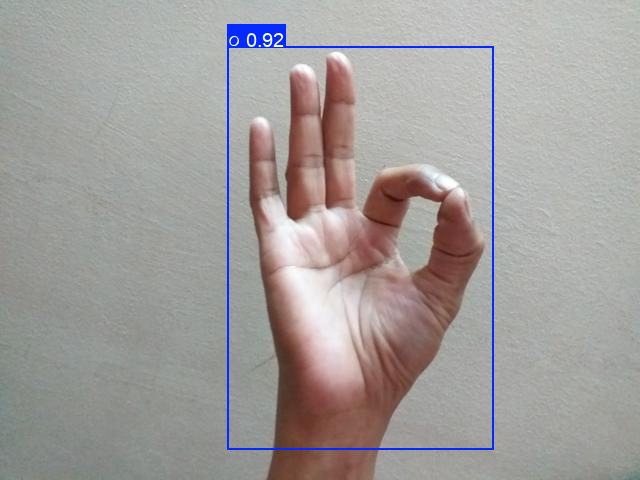

In [28]:
from ultralytics import YOLO
import os

# Correct image path after locating the correct file
image_path = "/kaggle/input/numerical-one-hand-sign/Data Sign lanuage/train/images/Sign 0 - Sample (10).jpg"

# Check if file exists
if os.path.exists(image_path):
    # Load trained model
    model = YOLO("runs/detect/train/weights/best.pt")

    # Run inference
    results = model.predict(image_path, save=True, conf=0.5)

    # Process and display results with Bangla labels
    bangla_map = {
        0: "০", 1: "১", 2: "২", 3: "৩", 4: "৪",
        5: "৫", 6: "৬", 7: "৭", 8: "৮", 9: "৯"
    }

    for result in results:
        for box in result.boxes:
            class_id = int(box.cls[0].item())  # Get class index
            bangla_label = bangla_map.get(class_id, "Unknown")  # Get Bangla label
            print(f"Detected: {bangla_label}")  # Print detected label in Bangla

        result.show()
else:
    print("⚠️ Image not found!")



image 1/1 /kaggle/input/numerical-one-hand-sign/Data Sign lanuage/valid/images/Sign-1-Sample-56-_jpg.rf.7ed49762b16c3c4812c3ebe6084ab2f5.jpg: 640x640 1 ১, 16.4ms
Speed: 1.4ms preprocess, 16.4ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs/detect/predict2
Detected: ১


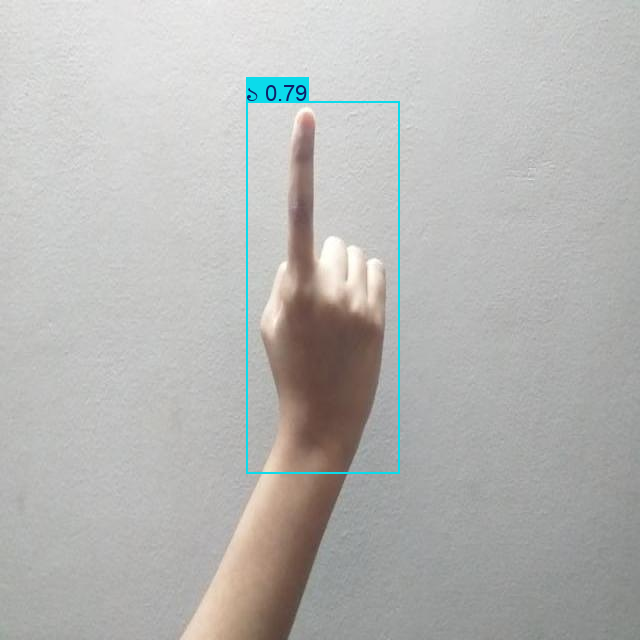

In [29]:
from ultralytics import YOLO
import os

# Correct image path after locating the correct file
image_path = "/kaggle/input/numerical-one-hand-sign/Data Sign lanuage/valid/images/Sign-1-Sample-56-_jpg.rf.7ed49762b16c3c4812c3ebe6084ab2f5.jpg"

# Check if file exists
if os.path.exists(image_path):
    # Load trained model
    model = YOLO("runs/detect/train/weights/best.pt")

    # Run inference
    results = model.predict(image_path, save=True, conf=0.5)

    # Process and display results with Bangla labels
    bangla_map = {
        0: "০", 1: "১", 2: "২", 3: "৩", 4: "৪",
        5: "৫", 6: "৬", 7: "৭", 8: "৮", 9: "৯"
    }

    for result in results:
        for box in result.boxes:
            class_id = int(box.cls[0].item())  # Get class index
            bangla_label = bangla_map.get(class_id, "Unknown")  # Get Bangla label
            print(f"Detected: {bangla_label}")  # Print detected label in Bangla

        result.show()
else:
    print("⚠️ Image not found!")



image 1/1 /kaggle/input/numerical-one-hand-sign/Data Sign lanuage/valid/images/Sign-2-Sample-128-_jpg.rf.359993d0918a5dbc5d6d4c368a187ba2.jpg: 640x640 1 ২, 16.3ms
Speed: 1.4ms preprocess, 16.3ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs/detect/predict3
Detected: ২


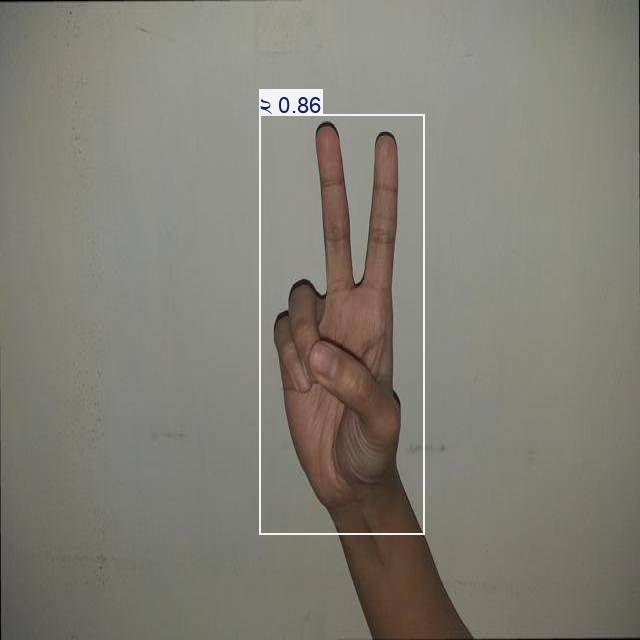

In [30]:
from ultralytics import YOLO
import os

# Correct image path after locating the correct file
image_path = "/kaggle/input/numerical-one-hand-sign/Data Sign lanuage/valid/images/Sign-2-Sample-128-_jpg.rf.359993d0918a5dbc5d6d4c368a187ba2.jpg"

# Check if file exists
if os.path.exists(image_path):
    # Load trained model
    model = YOLO("runs/detect/train/weights/best.pt")

    # Run inference
    results = model.predict(image_path, save=True, conf=0.5)

    # Process and display results with Bangla labels
    bangla_map = {
        0: "০", 1: "১", 2: "২", 3: "৩", 4: "৪",
        5: "৫", 6: "৬", 7: "৭", 8: "৮", 9: "৯"
    }

    for result in results:
        for box in result.boxes:
            class_id = int(box.cls[0].item())  # Get class index
            bangla_label = bangla_map.get(class_id, "Unknown")  # Get Bangla label
            print(f"Detected: {bangla_label}")  # Print detected label in Bangla

        result.show()
else:
    print("⚠️ Image not found!")



image 1/1 /kaggle/input/numerical-one-hand-sign/Data Sign lanuage/valid/images/Sign-3-Sample-165-_jpg.rf.566170c5eb38cd6f0f977c02e2018251.jpg: 640x640 1 ৩, 16.3ms
Speed: 1.5ms preprocess, 16.3ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs/detect/predict4
Detected: ৩


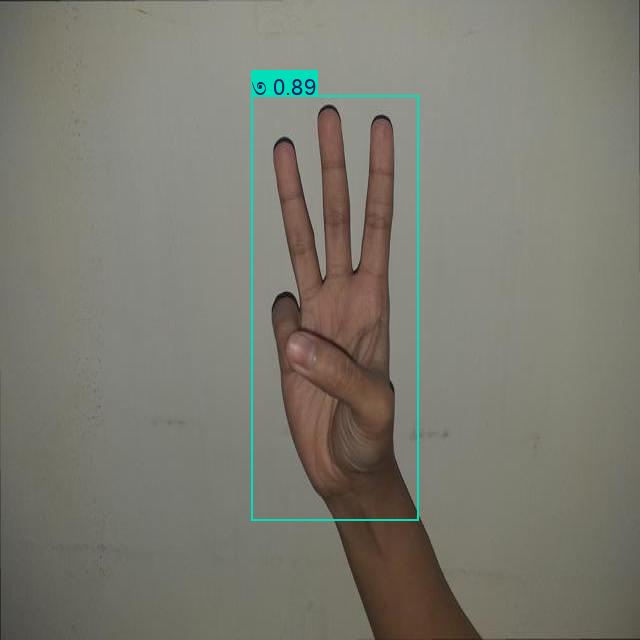

In [31]:
from ultralytics import YOLO
import os

# Correct image path after locating the correct file
image_path = "/kaggle/input/numerical-one-hand-sign/Data Sign lanuage/valid/images/Sign-3-Sample-165-_jpg.rf.566170c5eb38cd6f0f977c02e2018251.jpg"

# Check if file exists
if os.path.exists(image_path):
    # Load trained model
    model = YOLO("runs/detect/train/weights/best.pt")

    # Run inference
    results = model.predict(image_path, save=True, conf=0.5)

    # Process and display results with Bangla labels
    bangla_map = {
        0: "০", 1: "১", 2: "২", 3: "৩", 4: "৪",
        5: "৫", 6: "৬", 7: "৭", 8: "৮", 9: "৯"
    }

    for result in results:
        for box in result.boxes:
            class_id = int(box.cls[0].item())  # Get class index
            bangla_label = bangla_map.get(class_id, "Unknown")  # Get Bangla label
            print(f"Detected: {bangla_label}")  # Print detected label in Bangla

        result.show()
else:
    print("⚠️ Image not found!")



image 1/1 /kaggle/input/numerical-one-hand-sign/Data Sign lanuage/valid/images/Sign-4-Sample-223-_jpg.rf.41112bb345253a63e9a48555cf1ff08f.jpg: 640x640 1 ৪, 16.3ms
Speed: 1.4ms preprocess, 16.3ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs/detect/predict5
Detected: ৪


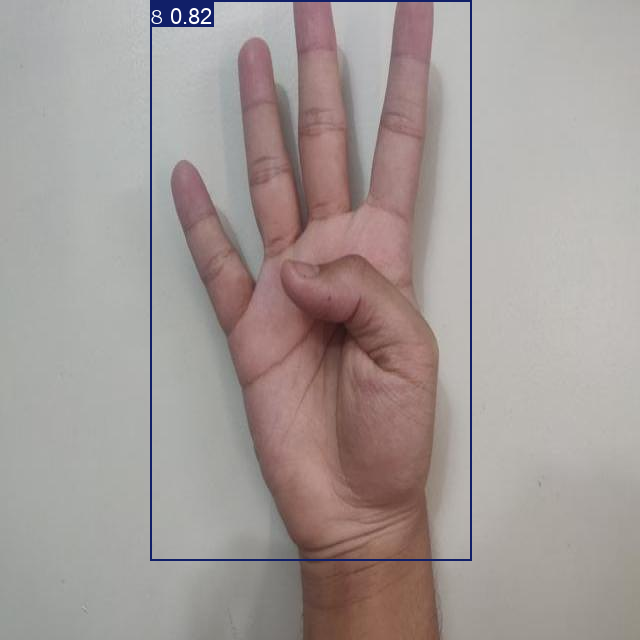

In [32]:
from ultralytics import YOLO
import os

# Correct image path after locating the correct file
image_path = "/kaggle/input/numerical-one-hand-sign/Data Sign lanuage/valid/images/Sign-4-Sample-223-_jpg.rf.41112bb345253a63e9a48555cf1ff08f.jpg"

# Check if file exists
if os.path.exists(image_path):
    # Load trained model
    model = YOLO("runs/detect/train/weights/best.pt")

    # Run inference
    results = model.predict(image_path, save=True, conf=0.5)

    # Process and display results with Bangla labels
    bangla_map = {
        0: "০", 1: "১", 2: "২", 3: "৩", 4: "৪",
        5: "৫", 6: "৬", 7: "৭", 8: "৮", 9: "৯"
    }

    for result in results:
        for box in result.boxes:
            class_id = int(box.cls[0].item())  # Get class index
            bangla_label = bangla_map.get(class_id, "Unknown")  # Get Bangla label
            print(f"Detected: {bangla_label}")  # Print detected label in Bangla

        result.show()
else:
    print("⚠️ Image not found!")



image 1/1 /kaggle/input/numerical-one-hand-sign/Data Sign lanuage/valid/images/Sign-5-Sample-265-_jpg.rf.0b28c4bf64416cde45b40f99da486684.jpg: 640x640 1 ৫, 16.3ms
Speed: 1.5ms preprocess, 16.3ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs/detect/predict6
Detected: ৫


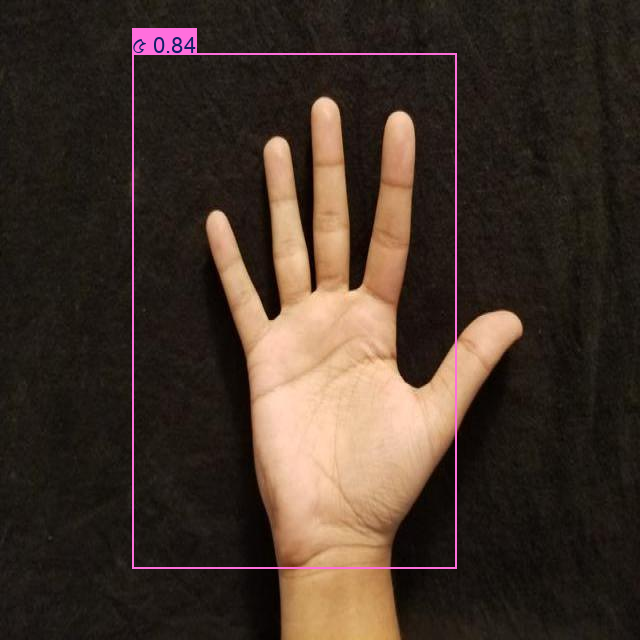

In [33]:
from ultralytics import YOLO
import os

# Correct image path after locating the correct file
image_path = "/kaggle/input/numerical-one-hand-sign/Data Sign lanuage/valid/images/Sign-5-Sample-265-_jpg.rf.0b28c4bf64416cde45b40f99da486684.jpg"

# Check if file exists
if os.path.exists(image_path):
    # Load trained model
    model = YOLO("runs/detect/train/weights/best.pt")

    # Run inference
    results = model.predict(image_path, save=True, conf=0.5)

    # Process and display results with Bangla labels
    bangla_map = {
        0: "০", 1: "১", 2: "২", 3: "৩", 4: "৪",
        5: "৫", 6: "৬", 7: "৭", 8: "৮", 9: "৯"
    }

    for result in results:
        for box in result.boxes:
            class_id = int(box.cls[0].item())  # Get class index
            bangla_label = bangla_map.get(class_id, "Unknown")  # Get Bangla label
            print(f"Detected: {bangla_label}")  # Print detected label in Bangla

        result.show()
else:
    print("⚠️ Image not found!")



image 1/1 /kaggle/input/numerical-one-hand-sign/Data Sign lanuage/valid/images/Sign-6-Sample-323-_jpg.rf.f4e8c1b30943a489053dbeb5b3f8343d.jpg: 640x640 1 ৬, 16.0ms
Speed: 4.5ms preprocess, 16.0ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs/detect/predict7
Detected: ৬


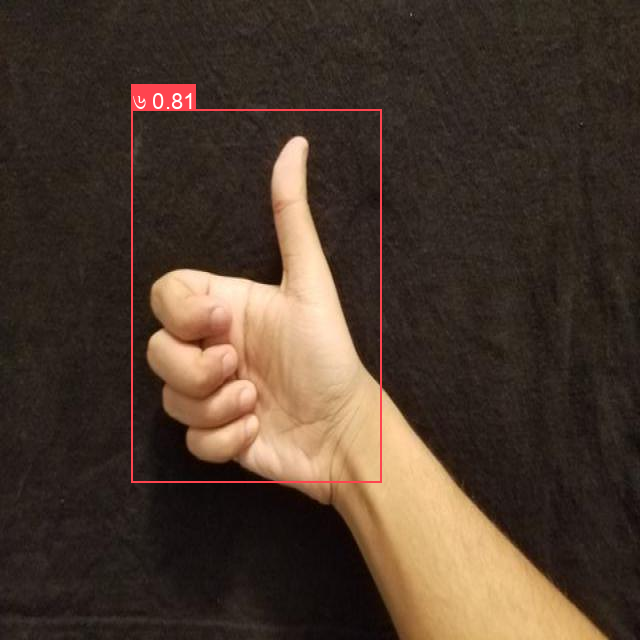

In [34]:
from ultralytics import YOLO
import os

# Correct image path after locating the correct file
image_path = "/kaggle/input/numerical-one-hand-sign/Data Sign lanuage/valid/images/Sign-6-Sample-323-_jpg.rf.f4e8c1b30943a489053dbeb5b3f8343d.jpg"

# Check if file exists
if os.path.exists(image_path):
    # Load trained model
    model = YOLO("runs/detect/train/weights/best.pt")

    # Run inference
    results = model.predict(image_path, save=True, conf=0.5)

    # Process and display results with Bangla labels
    bangla_map = {
        0: "০", 1: "১", 2: "২", 3: "৩", 4: "৪",
        5: "৫", 6: "৬", 7: "৭", 8: "৮", 9: "৯"
    }

    for result in results:
        for box in result.boxes:
            class_id = int(box.cls[0].item())  # Get class index
            bangla_label = bangla_map.get(class_id, "Unknown")  # Get Bangla label
            print(f"Detected: {bangla_label}")  # Print detected label in Bangla

        result.show()
else:
    print("⚠️ Image not found!")



image 1/1 /kaggle/input/numerical-one-hand-sign/Data Sign lanuage/valid/images/Sign-7-Sample-363-_jpg.rf.93deb2205bd75195295c15a36c1e26b0.jpg: 640x640 1 ৭, 16.3ms
Speed: 1.5ms preprocess, 16.3ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs/detect/predict8
Detected: ৭


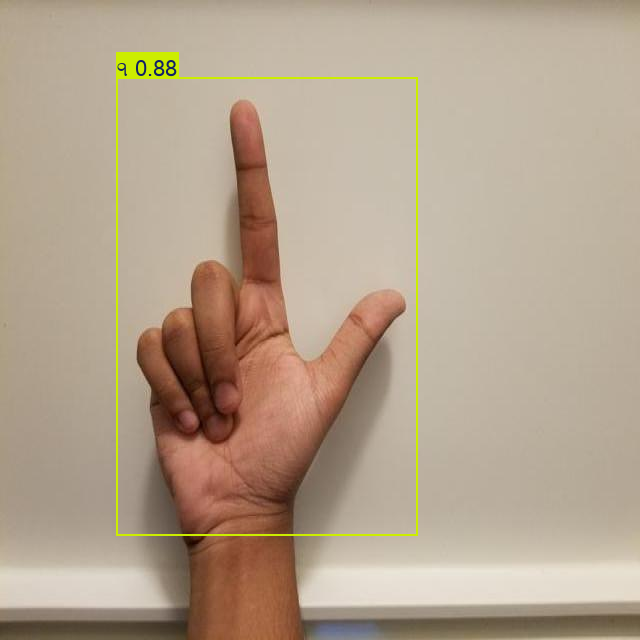

In [35]:
from ultralytics import YOLO
import os

# Correct image path after locating the correct file
image_path = "/kaggle/input/numerical-one-hand-sign/Data Sign lanuage/valid/images/Sign-7-Sample-363-_jpg.rf.93deb2205bd75195295c15a36c1e26b0.jpg"

# Check if file exists
if os.path.exists(image_path):
    # Load trained model
    model = YOLO("runs/detect/train/weights/best.pt")

    # Run inference
    results = model.predict(image_path, save=True, conf=0.5)

    # Process and display results with Bangla labels
    bangla_map = {
        0: "০", 1: "১", 2: "২", 3: "৩", 4: "৪",
        5: "৫", 6: "৬", 7: "৭", 8: "৮", 9: "৯"
    }

    for result in results:
        for box in result.boxes:
            class_id = int(box.cls[0].item())  # Get class index
            bangla_label = bangla_map.get(class_id, "Unknown")  # Get Bangla label
            print(f"Detected: {bangla_label}")  # Print detected label in Bangla

        result.show()
else:
    print("⚠️ Image not found!")



image 1/1 /kaggle/input/numerical-one-hand-sign/Data Sign lanuage/valid/images/Sign-8-Sample-426-_jpg.rf.981a406c8154e7eb618ae6de91a7c799.jpg: 640x640 1 ৮, 16.4ms
Speed: 1.5ms preprocess, 16.4ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs/detect/predict9
Detected: ৮


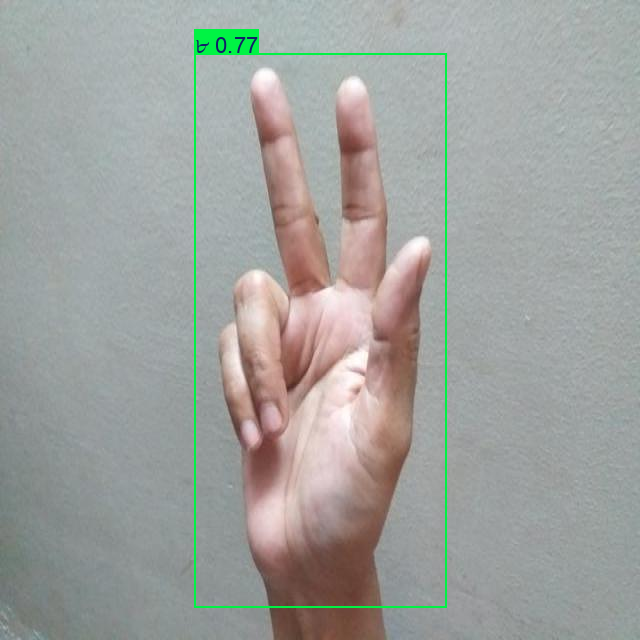

In [36]:
from ultralytics import YOLO
import os

# Correct image path after locating the correct file
image_path = "/kaggle/input/numerical-one-hand-sign/Data Sign lanuage/valid/images/Sign-8-Sample-426-_jpg.rf.981a406c8154e7eb618ae6de91a7c799.jpg"

# Check if file exists
if os.path.exists(image_path):
    # Load trained model
    model = YOLO("runs/detect/train/weights/best.pt")

    # Run inference
    results = model.predict(image_path, save=True, conf=0.5)

    # Process and display results with Bangla labels
    bangla_map = {
        0: "০", 1: "১", 2: "২", 3: "৩", 4: "৪",
        5: "৫", 6: "৬", 7: "৭", 8: "৮", 9: "৯"
    }

    for result in results:
        for box in result.boxes:
            class_id = int(box.cls[0].item())  # Get class index
            bangla_label = bangla_map.get(class_id, "Unknown")  # Get Bangla label
            print(f"Detected: {bangla_label}")  # Print detected label in Bangla

        result.show()
else:
    print("⚠️ Image not found!")



image 1/1 /kaggle/input/numerical-one-hand-sign/Data Sign lanuage/valid/images/Sign-8-Sample-430-_jpg.rf.aa756dbc1390f027b0020925dc6d40da.jpg: 640x640 1 ৮, 16.2ms
Speed: 1.4ms preprocess, 16.2ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs/detect/predict10
Detected: ৮


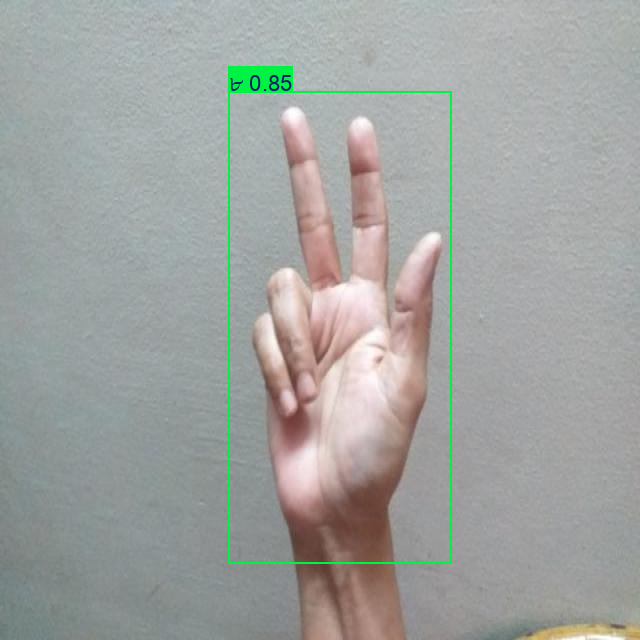

In [37]:
from ultralytics import YOLO
import os

# Correct image path after locating the correct file
image_path = "/kaggle/input/numerical-one-hand-sign/Data Sign lanuage/valid/images/Sign-8-Sample-430-_jpg.rf.aa756dbc1390f027b0020925dc6d40da.jpg"

# Check if file exists
if os.path.exists(image_path):
    # Load trained model
    model = YOLO("runs/detect/train/weights/best.pt")

    # Run inference
    results = model.predict(image_path, save=True, conf=0.5)

    # Process and display results with Bangla labels
    bangla_map = {
        0: "০", 1: "১", 2: "২", 3: "৩", 4: "৪",
        5: "৫", 6: "৬", 7: "৭", 8: "৮", 9: "৯"
    }

    for result in results:
        for box in result.boxes:
            class_id = int(box.cls[0].item())  # Get class index
            bangla_label = bangla_map.get(class_id, "Unknown")  # Get Bangla label
            print(f"Detected: {bangla_label}")  # Print detected label in Bangla

        result.show()
else:
    print("⚠️ Image not found!")



image 1/1 /kaggle/input/numerical-one-hand-sign/Data Sign lanuage/valid/images/Sign-9-Sample-461-_jpg.rf.21b4157992e83bd749b7dfa86672db63.jpg: 640x640 1 ৯, 16.3ms
Speed: 1.7ms preprocess, 16.3ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs/detect/predict11
Detected: ৯


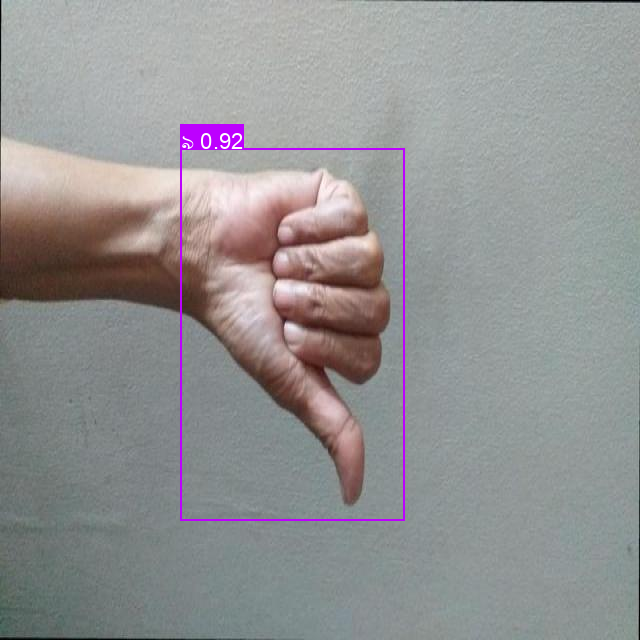

In [38]:
from ultralytics import YOLO
import os

# Correct image path after locating the correct file
image_path = "/kaggle/input/numerical-one-hand-sign/Data Sign lanuage/valid/images/Sign-9-Sample-461-_jpg.rf.21b4157992e83bd749b7dfa86672db63.jpg"

# Check if file exists
if os.path.exists(image_path):
    # Load trained model
    model = YOLO("runs/detect/train/weights/best.pt")

    # Run inference
    results = model.predict(image_path, save=True, conf=0.5)

    # Process and display results with Bangla labels
    bangla_map = {
        0: "০", 1: "১", 2: "২", 3: "৩", 4: "৪",
        5: "৫", 6: "৬", 7: "৭", 8: "৮", 9: "৯"
    }

    for result in results:
        for box in result.boxes:
            class_id = int(box.cls[0].item())  # Get class index
            bangla_label = bangla_map.get(class_id, "Unknown")  # Get Bangla label
            print(f"Detected: {bangla_label}")  # Print detected label in Bangla

        result.show()
else:
    print("⚠️ Image not found!")



image 1/1 /kaggle/input/numerical-one-hand-sign/Data Sign lanuage/valid/images/Sign-9-Sample-475-_jpg.rf.122a1bf8a8120ea21d9a08eabd6cbc1e.jpg: 640x640 1 ৯, 16.4ms
Speed: 1.5ms preprocess, 16.4ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs/detect/predict12
Detected: ৯


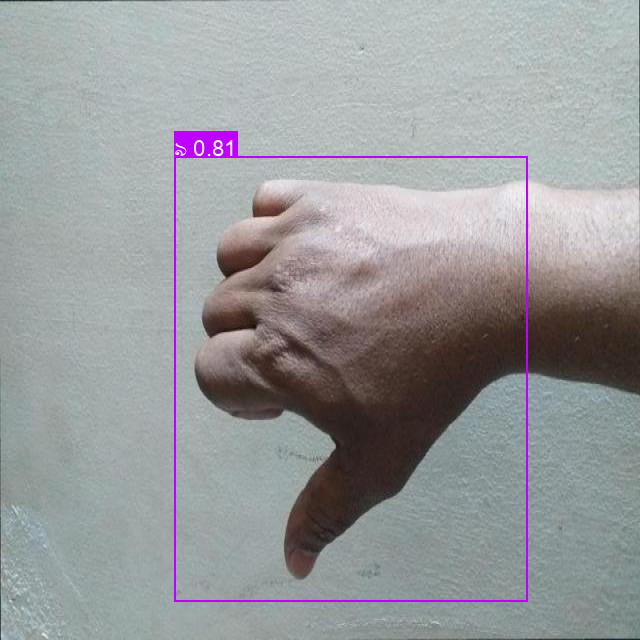

In [39]:
from ultralytics import YOLO
import os

# Correct image path after locating the correct file
image_path = "/kaggle/input/numerical-one-hand-sign/Data Sign lanuage/valid/images/Sign-9-Sample-475-_jpg.rf.122a1bf8a8120ea21d9a08eabd6cbc1e.jpg"

# Check if file exists
if os.path.exists(image_path):
    # Load trained model
    model = YOLO("runs/detect/train/weights/best.pt")

    # Run inference
    results = model.predict(image_path, save=True, conf=0.5)

    # Process and display results with Bangla labels
    bangla_map = {
        0: "০", 1: "১", 2: "২", 3: "৩", 4: "৪",
        5: "৫", 6: "৬", 7: "৭", 8: "৮", 9: "৯"
    }

    for result in results:
        for box in result.boxes:
            class_id = int(box.cls[0].item())  # Get class index
            bangla_label = bangla_map.get(class_id, "Unknown")  # Get Bangla label
            print(f"Detected: {bangla_label}")  # Print detected label in Bangla

        result.show()
else:
    print("⚠️ Image not found!")


In [40]:
# After training (assuming your previous code ran successfully)
import pandas as pd

# Load results.csv
results_csv = pd.read_csv('/kaggle/working/runs/detect/train/results.csv')

# Strip whitespace from column names (Ultralytics adds padding)
results_csv.columns = results_csv.columns.str.strip()

# Display last row (final epoch metrics)
final_metrics = results_csv.iloc[-1]
print("Final Validation Metrics:")
print(f"Precision: {final_metrics['metrics/precision(B)']:.3f}")
print(f"Recall: {final_metrics['metrics/recall(B)']:.3f}")
print(f"mAP@0.5: {final_metrics['metrics/mAP50(B)']:.3f} (proxy for accuracy)")
print(f"mAP@0.5:0.95: {final_metrics['metrics/mAP50-95(B)']:.3f}")

# Optionally, show all epochs
print("\nFull Results Table:")
print(results_csv[['epoch', 'metrics/precision(B)', 'metrics/recall(B)', 'metrics/mAP50(B)', 'metrics/mAP50-95(B)']])

Final Validation Metrics:
Precision: 0.928
Recall: 0.880
mAP@0.5: 0.941 (proxy for accuracy)
mAP@0.5:0.95: 0.591

Full Results Table:
    epoch  metrics/precision(B)  metrics/recall(B)  metrics/mAP50(B)  \
0       1               0.47338            0.63027           0.57540   
1       2               0.57992            0.79754           0.76844   
2       3               0.69857            0.53916           0.67898   
3       4               0.73600            0.74829           0.79782   
4       5               0.60614            0.78517           0.80674   
..    ...                   ...                ...               ...   
95     96               0.91855            0.89271           0.94149   
96     97               0.91558            0.90421           0.94773   
97     98               0.91159            0.91343           0.94894   
98     99               0.92470            0.87541           0.93675   
99    100               0.92779            0.88033           0.94128   

 

In [41]:
!pip install opencv-python
!pip install ultralytics


In [ ]:
import cv2
from ultralytics import YOLO
import numpy as np
import time
from PIL import Image, ImageDraw, ImageFont

# Load the trained model
model = YOLO("runs/detect/train/weights/best.pt")

# Initialize webcam
cap = cv2.VideoCapture(0)  # 0 is default webcam
if not cap.isOpened():
    print("⚠️ Could not open webcam!")
    exit()

# Set webcam resolution (optional, adjust based on camera)
cap.set(cv2.CAP_PROP_FRAME_WIDTH, 1280)
cap.set(cv2.CAP_PROP_FRAME_HEIGHT, 720)

# FPS calculation variables
prev_time = 0

# Confidence threshold to filter weak detections
CONF_THRESHOLD = 0.5

# Load custom Bangla font (fallback if cv2.putText fails)
try:
    font_path = "path/to/SutonnyMJ.ttf"  # Replace with your Bangla .ttf file path
    font = ImageFont.truetype(font_path, 30)  # Size 30
    use_custom_font = True
except:
    print("⚠️ Custom Bangla font not found. Using default font.")
    use_custom_font = False

while True:
    # Capture frame-by-frame
    ret, frame = cap.read()
    if not ret:
        print("⚠️ Failed to capture image!")
        break

    # Step 1: Define Region of Interest (ROI) for hand detection
    height, width = frame.shape[:2]
    roi_size = int(min(height, width) * 0.7)  # 70% of smaller dimension
    start_x = (width - roi_size) // 2
    start_y = (height - roi_size) // 2
    roi = frame[start_y:start_y + roi_size, start_x:start_x + roi_size]

    # Step 2: Resize ROI to match training size (imgsz=640)
    roi_resized = cv2.resize(roi, (640, 640), interpolation=cv2.INTER_AREA)

    # Step 3: Enhance contrast for better detection
    roi_resized = cv2.convertScaleAbs(roi_resized, alpha=1.2, beta=10)

    # Step 4: Run inference on the ROI
    results = model(roi_resized)

    # Step 5: Process detections
    for result in results:
        for box in result.boxes:
            # Get confidence and class ID
            conf = box.conf[0].item()
            if conf < CONF_THRESHOLD:
                continue  # Skip low-confidence detections
            
            class_id = int(box.cls[0].item())
            # Get Bangla label directly from model (assuming trained with ০-৯)
            bangla_label = result.names[class_id]
            label = f"{bangla_label} {conf:.2f}"

            # Map coordinates back to original frame
            x1, y1, x2, y2 = map(int, box.xyxy[0])
            scale_factor = roi_size / 640
            x1 = int(x1 * scale_factor) + start_x
            y1 = int(y1 * scale_factor) + start_y
            x2 = int(x2 * scale_factor) + start_x
            y2 = int(y2 * scale_factor) + start_y

            # Draw bounding box
            cv2.rectangle(frame, (x1, y1), (x2, y2), (0, 255, 0), 2)

            # Draw label (custom font fallback)
            if use_custom_font:
                # Convert frame to PIL for custom font
                pil_img = Image.fromarray(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
                draw = ImageDraw.Draw(pil_img)
                draw.text((x1, y1 - 20), label, font=font, fill=(0, 255, 0, 255))
                frame = cv2.cvtColor(np.array(pil_img), cv2.COLOR_RGB2BGR)
            else:
                cv2.putText(frame, label, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 255, 0), 2)

    # Step 6: Draw ROI boundary (debugging)
    cv2.rectangle(frame, (start_x, start_y), (start_x + roi_size, start_y + roi_size), (255, 0, 0), 2)

    # Step 7: Calculate and display FPS
    curr_time = time.time()
    fps = 1 / (curr_time - prev_time) if prev_time > 0 else 0
    prev_time = curr_time
    cv2.putText(frame, f"FPS: {fps:.1f}", (10, 30), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 255, 255), 2)

    # Display the frame
    cv2.imshow('Webcam Feed - Bangla Sign Language Detection', frame)

    # Press 'q' to quit
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

# Cleanup
cap.release()
cv2.destroyAllWindows()
print("✅ Detection stopped!")